In [1]:
import gensim
import spacy
from sklearn.metrics import confusion_matrix, jaccard_score, make_scorer, hamming_loss, f1_score, classification_report, precision_recall_fscore_support, average_precision_score, multilabel_confusion_matrix
import nltk
from sklearn.neighbors import KNeighborsClassifier, RadiusNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
import re
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from yellowbrick.classifier import PrecisionRecallCurve
from xgboost.sklearn import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import PassiveAggressiveClassifier, RidgeClassifierCV
from sklearn.linear_model import Perceptron
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.naive_bayes import MultinomialNB
from scipy.sparse import hstack
from string import punctuation
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import wordnet
from nltk.tokenize import ToktokTokenizer
from matplotlib.collections import LineCollection
from sklearn.svm import LinearSVC
from sklearn.preprocessing import MultiLabelBinarizer, StandardScaler
from sklearn.multiclass import OneVsRestClassifier
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, cross_val_score, KFold, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.dummy import DummyClassifier
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from bs4 import BeautifulSoup
import warnings
import matplotlib.pyplot as plt
import numpy as np
import itertools
import pandas as pd
import seaborn as sns
import pickle
import pyLDAvis.sklearn
%matplotlib inline

!pip install pyLDAvis
!pip install - U gensim


warnings.filterwarnings('ignore')

plt.style.use('bmh')
# We load our data and visualize the first 50 lines.

nltk.download("stopwords")
nltk.download("wordnet")
sns.set()
pd.set_option('display.width', 1000)

c:\program files\python37\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


ERROR: Invalid requirement: '-'
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\mehdi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\mehdi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
df = pd.read_csv(
    r'C:\Users\mehdi\OneDrive\Documents\OpenClassRooms\Projet 5\QueryResults22122019.csv')

In [3]:
df

,Id,PostTypeId,AcceptedAnswerId,ParentId,CreationDate,DeletionDate,Score,ViewCount,Body,OwnerUserId,...,LastEditorDisplayName,LastEditDate,LastActivityDate,Title,Tags,AnswerCount,CommentCount,FavoriteCount,ClosedDate,CommunityOwnedDate
0,19339,1,19343.0,NaN,2008-08-21 04:29:07,NaN,483,149472,<p>I have a list of 2-item tuples and I'd like...,680.0,...,NaN,2019-03-27 12:23:53,2019-04-22 17:34:33,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>,11,2,121,NaN,NaN
1,19412,1,19419.0,NaN,2008-08-21 06:28:49,NaN,498,420676,<p>How can I request a random row (or as close...,473.0,...,Yaakov Ellis,2014-07-07 13:26:48,2018-07-06 07:59:29,How to request a random row in SQL?,<sql><random>,28,4,166,NaN,NaN
2,21027,1,4099033.0,NaN,2008-08-21 20:07:59,NaN,281,69287,<p>Is it possible to change how <kbd>Ctrl</kbd...,2277.0,...,Mark Biek,2014-01-22 17:46:01,2017-09-28 15:13:38,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>,12,14,62,NaN,NaN
3,21078,1,21093.0,NaN,2008-08-21 20:27:15,NaN,272,196522,<p>What's the most efficient way to concatenat...,2358.0,...,Andy Lester,2016-09-18 00:41:19,2019-11-22 09:07:49,Most efficient way to concatenate strings?,<c#><.net><string><optimization>,17,6,85,NaN,NaN
4,21133,1,21189.0,NaN,2008-08-21 20:40:38,NaN,285,179538,<p>What's the easiest way to profile a PHP scr...,305.0,...,user212218,2012-08-13 00:00:26,2019-03-22 01:52:03,Simplest way to profile a PHP script,<php><profiling>,12,2,155,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20023,38394015,1,38397755.0,NaN,2016-07-15 10:37:32,NaN,165,190063,<p>I'm trying to send data from a child compon...,3711985.0,...,NaN,NaN,2019-11-26 23:51:16,How to pass data from child component to its p...,<reactjs>,7,6,53,NaN,NaN
20024,47860772,1,NaN,NaN,2017-12-18 00:26:53,NaN,184,303530,<p>I am on mac OS unlike this post: </p>\n\n<u...,7670029.0,...,NaN,2019-09-22 03:44:26,2019-12-13 08:43:35,GitLab remote: HTTP Basic: Access denied and f...,<git><gitlab>,33,0,78,NaN,NaN
20025,38630076,1,38935583.0,NaN,2016-07-28 07:44:05,NaN,232,159088,<p>I started using ASP.NET Core for my new RES...,2061604.0,...,NaN,2019-03-14 23:09:51,2019-11-04 11:10:57,ASP.NET Core Web API exception handling,<c#><exception><asp.net-core>,8,2,138,NaN,NaN
20026,38714959,1,38737941.0,NaN,2016-08-02 08:04:13,NaN,267,40448,<p>I am trying to reconcile my understand of L...,2530674.0,...,NaN,2018-08-17 00:01:23,2019-12-03 16:02:08,Understanding Keras LSTMs,<python><deep-learning><keras><lstm>,3,9,248,NaN,NaN


In [4]:
df.columns

Index(['Id', 'PostTypeId', 'AcceptedAnswerId', 'ParentId', 'CreationDate', 'DeletionDate', 'Score', 'ViewCount', 'Body', 'OwnerUserId', 'OwnerDisplayName', 'LastEditorUserId', 'LastEditorDisplayName', 'LastEditDate', 'LastActivityDate', 'Title', 'Tags', 'AnswerCount', 'CommentCount', 'FavoriteCount', 'ClosedDate', 'CommunityOwnedDate'], dtype='object')

In [5]:
# We only select the lines which are the first messages of each issue : the other lines are just responses and doesn't contains
# any tag
df = df[['Body', 'Title', 'Tags']][df['PostTypeId'] == 1]
# And we reset the index values :
df.index = range(len(df))
df.head()

,Body,Title,Tags
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,<sql><random>
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,<c#><.net><string><optimization>
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,<php><profiling>


In [6]:
df['Text'] = df['Title']+'_'+df['Body']
df.head()

,Body,Title,Tags,Text
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>,Transpose/Unzip Function (inverse of zip)?_<p>...
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,<sql><random>,How to request a random row in SQL?_<p>How can...
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>,Changing Ctrl + Tab behavior for moving betwee...
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,<c#><.net><string><optimization>,Most efficient way to concatenate strings?_<p>...
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,<php><profiling>,Simplest way to profile a PHP script_<p>What's...


In [7]:
# We save the old DataFrame index :
df['id'] = df.index
df.head()

,Body,Title,Tags,Text,id
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>,Transpose/Unzip Function (inverse of zip)?_<p>...,0
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,<sql><random>,How to request a random row in SQL?_<p>How can...,1
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>,Changing Ctrl + Tab behavior for moving betwee...,2
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,<c#><.net><string><optimization>,Most efficient way to concatenate strings?_<p>...,3
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,<php><profiling>,Simplest way to profile a PHP script_<p>What's...,4


In [8]:
df.head()

,Body,Title,Tags,Text,id
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>,Transpose/Unzip Function (inverse of zip)?_<p>...,0
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,<sql><random>,How to request a random row in SQL?_<p>How can...,1
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>,Changing Ctrl + Tab behavior for moving betwee...,2
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,<c#><.net><string><optimization>,Most efficient way to concatenate strings?_<p>...,3
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,<php><profiling>,Simplest way to profile a PHP script_<p>What's...,4


In [9]:
df['Text'] = df['Text'].str.lower()
df.head()

,Body,Title,Tags,Text,id
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,<python><list><matrix><transpose>,transpose/unzip function (inverse of zip)?_<p>...,0
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,<sql><random>,how to request a random row in sql?_<p>how can...,1
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,<visual-studio>,changing ctrl + tab behavior for moving betwee...,2
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,<c#><.net><string><optimization>,most efficient way to concatenate strings?_<p>...,3
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,<php><profiling>,simplest way to profile a php script_<p>what's...,4


# Applying pre-processing functions

In [10]:
def count_tag(data, ref_col, list_words):
    ''' Count the number of occurrences and the average score for each tag

    Parameters:

        data (dataframe): dataframe to use 
        ref_col (serie): column of dataframe containing tags
        list_words (list): list of different tags
    '''

    keyword_count = dict()
    index = -1

    for s in list_words:
        keyword_count[s] = []
        keyword_count[s].append(0)
        keyword_count[s].append(0)

    for list_keywords in data[ref_col].str.split('>'):

        if type(list_keywords) == float and pd.isnull(list_keywords):
            continue

        index += 1

        for s in [s for s in list_keywords if s in list_words]:
            if pd.notnull(s):
                keyword_count[s][0] += 1

    # conversion of our dictionary into a list
    keyword_occurences = []

    for tag, item in keyword_count.items():
        keyword_occurences.append([tag[1:], item[0], item[1]/item[0]])

    keyword_occurences.sort(key=lambda x: x[1], reverse=True)

    return keyword_occurences

In [11]:
# Making a list of the different tags

set_tags = set()
scoring = list()

for list_keywords in df['Tags'].str.split('>').values:

    if isinstance(list_keywords, float):
        continue

    set_tags = set_tags.union(list_keywords)

print('There are %d tags' % len(set_tags))

There are 6997 tags


In [12]:
# I decided to keep the 400 most popular tags because they represent more than 95%
# of all the posts, and also because it'll be easier to predict the right tags
# from 400 words than from 6997 and because we want to keep macro tags and
# not be too specific since it's only a recommendation for a post

keyword_occurences = count_tag(df, 'Tags', set_tags)
trunc_occurences = keyword_occurences[1:401]
top_tags = [i[0] for i in trunc_occurences]


def most_common(tags):
    ''' keep only the tags that are part of the 400 most used tags
    on StackOverflow

    tags: tags associated to post
    '''

    clean_tags = str(tags).split('>')[:-1]
    tags_filtered = []

    for tag in clean_tags:

        if tag[1:] in top_tags:
            tags_filtered.append(tag[1:])

    return tags_filtered

In [90]:
# SAUVEGARDE
with open('top_tags.pkl', 'wb') as f:
    pickle.dump(top_tags, f)

In [13]:
df['Tags'] = df['Tags'].apply(lambda x: most_common(x))
df['Tags'] = df['Tags'].apply(lambda x: x if len(x) > 0 else None)

In [14]:
df.dropna(subset=['Tags'], inplace=True)
df.shape

(19446, 5)

In [15]:
df.head(5)

,Body,Title,Tags,Text,id
0,<p>I have a list of 2-item tuples and I'd like...,Transpose/Unzip Function (inverse of zip)?,"[python, list]",transpose/unzip function (inverse of zip)?_<p>...,0
1,<p>How can I request a random row (or as close...,How to request a random row in SQL?,"[sql, random]",how to request a random row in sql?_<p>how can...,1
2,<p>Is it possible to change how <kbd>Ctrl</kbd...,Changing Ctrl + Tab behavior for moving betwee...,[visual-studio],changing ctrl + tab behavior for moving betwee...,2
3,<p>What's the most efficient way to concatenat...,Most efficient way to concatenate strings?,"[c#, .net, string, optimization]",most efficient way to concatenate strings?_<p>...,3
4,<p>What's the easiest way to profile a PHP scr...,Simplest way to profile a PHP script,"[php, profiling]",simplest way to profile a php script_<p>what's...,4


In [16]:
def clean_text(text):
    ''' Lowering text and removing undesirable marks

    Parameter:

    text: document to be cleaned    
    '''

    text = text.lower()
    text = re.sub(r"\'\n", " ", text)
    text = re.sub(r"\'\xa0", " ", text)
    text = re.sub('\s+', ' ', text)  # matches all whitespace characters
    text = text.strip(' ')
    return text

In [17]:
df['Body'] = df['Body'].apply(lambda x: clean_text(x))

In [18]:
# the text of the post, without tags or markup
df['Body'] = df['Body'].apply(lambda x: BeautifulSoup(x).get_text())

In [19]:
# the text field (body+title), without tags or markup
df['Text'] = df['Text'].apply(lambda x: BeautifulSoup(x).get_text())

In [20]:
df.head()

,Body,Title,Tags,Text,id
0,i have a list of 2-item tuples and i'd like to...,Transpose/Unzip Function (inverse of zip)?,"[python, list]",transpose/unzip function (inverse of zip)?_i h...,0
1,how can i request a random row (or as close to...,How to request a random row in SQL?,"[sql, random]",how to request a random row in sql?_how can i ...,1
2,is it possible to change how ctrl + tab and sh...,Changing Ctrl + Tab behavior for moving betwee...,[visual-studio],changing ctrl + tab behavior for moving betwee...,2
3,what's the most efficient way to concatenate s...,Most efficient way to concatenate strings?,"[c#, .net, string, optimization]",most efficient way to concatenate strings?_wha...,3
4,what's the easiest way to profile a php script...,Simplest way to profile a PHP script,"[php, profiling]",simplest way to profile a php script_what's th...,4


In [21]:
token = ToktokTokenizer()
punct = punctuation

In [22]:
def strip_list_noempty(mylist):

    newlist = (item.strip() if hasattr(item, 'strip')
               else item for item in mylist)

    return [item for item in newlist if item != '']

In [23]:
def clean_punct(text):
    ''' Remove all the punctuation from text, unless it's part of an important 
    tag (ex: c++, c#, etc)

    Parameter:

    text: document to remove punctuation from it
    '''

    words = token.tokenize(text)
    punctuation_filtered = []
    regex = re.compile('[%s]' % re.escape(punct))
    remove_punctuation = str.maketrans(' ', ' ', punct)

    for w in words:
        if w in top_tags:
            punctuation_filtered.append(w)
        else:
            w = re.sub('^[0-9]*', " ", w)
            punctuation_filtered.append(regex.sub('', w))

    filtered_list = strip_list_noempty(punctuation_filtered)

    return ' '.join(map(str, filtered_list))

In [24]:
stop_words = set(stopwords.words("english"))

In [25]:
def stopWordsRemove(text):
    ''' Removing all the english stop words from a corpus

    Parameter:

    text: document to remove stop words from it
    '''

    words = token.tokenize(text)
    filtered = [w for w in words if not w in stop_words]

    return ' '.join(map(str, filtered))

In [26]:
import en_core_web_sm
nlp = en_core_web_sm.load()


def lemmatization(texts, allowed_postags, stop_words=stop_words):
    ''' It keeps the lemma of the words (lemma is the uninflected form of a word),
    and deletes the underired POS tags

    Parameters:

    texts (list): text to lemmatize
    allowed_postags (list): list of allowed postags, like NOUN, ADL, VERB, ADV
    '''

    lemma = wordnet.WordNetLemmatizer()
    doc = nlp(texts)
    texts_out = []

    for token in doc:

        if str(token) in top_tags:
            texts_out.append(str(token))

        elif token.pos_ in allowed_postags:

            if token.lemma_ not in ['-PRON-']:
                texts_out.append(token.lemma_)

            else:
                texts_out.append('')

    texts_out = ' '.join(texts_out)

    return texts_out

In [27]:
df['Body'] = df['Body'].apply(lambda x: clean_punct(x))
df['Body'] = df['Body'].apply(lambda x: stopWordsRemove(x))
df['Body'] = df['Body'].apply(lambda x: lemmatization(x, ['NOUN', 'ADV']))

In [28]:
df['Title'] = df['Title'].apply(lambda x: clean_punct(x))
df['Title'] = df['Title'].apply(lambda x: stopWordsRemove(x))
df['Title'] = df['Title'].apply(lambda x: lemmatization(x, ['NOUN', 'ADV']))

In [29]:
df['Text'] = df['Text'].apply(lambda x: clean_punct(x))
df['Text'] = df['Text'].apply(lambda x: stopWordsRemove(x))
df['Text'] = df['Text'].apply(lambda x: lemmatization(x, ['NOUN', 'ADV']))

In [81]:
posts_text=df['Text']
posts_text

0        function list item tuple convert list first it...
1        random row sqlhow request random row close tru...
2        tab behavior document studiois change ctrl tab...
3                               way way concatenate string
4        php scriptwhat way php script love show functi...
                               ...                        
20023    child component parent reactjsi datum child co...
20024    http access post git push error http access pa...
20025    asp.net core web api exception handlingi asp.n...
20026    reconcile post kera mainly datum series sample...
20027    nsphotolibraryusagedescription infoplist camer...
Name: Text, Length: 19446, dtype: object

In [82]:
posts_top400tags = df['Tags']
posts_top400tags

0                          [python, list]
1                           [sql, random]
2                         [visual-studio]
3        [c#, .net, string, optimization]
4                        [php, profiling]
                       ...               
20023                           [reactjs]
20024                               [git]
20025                     [c#, exception]
20026                            [python]
20027                               [ios]
Name: Tags, Length: 19446, dtype: object

In [83]:
posts_text.to_pickle("./posts_text.pkl")
posts_top400tags.to_pickle("./posts_top400tags.pkl")

# Recommandation de tags : approche supervisée
    Binarisation des tags pour l'analyse supervisée
    Séparation des jeux de données en entraînement et validation
    Transformation de la variable Body et Text avec TF-IDF
    Equilibre des labels après split

In [32]:
# Sampling dataset
vectorizer_dfText = TfidfVectorizer(analyzer='word',
                                    min_df=0.001,
                                    max_df=0.1,
                                    strip_accents=None,
                                    encoding='utf-8',
                                    preprocessor=None,
                                    token_pattern=r'(?u)\b\w+\b',
                                    # token_pattern=r"(?u)\S\S+",
                                    max_features=2000)

# Binarisation des tags pour l'analyse supervisée
multilabel_binarizer = MultiLabelBinarizer()
y_target = multilabel_binarizer.fit_transform(df['Tags'])

# Séparation des jeux de données en entraînement et validation
X_train_bodytitle, X_test_bodytitle, y_train_bodytitle, y_test_bodytitle = train_test_split(
    df['Text'], y_target, test_size=0.2, train_size=0.8, random_state=0)

# Transformation de la variable Body et Text avec TF-IDF
X_tfidf_train_bodytitle = vectorizer_dfText.fit_transform(X_train_bodytitle)
X_tfidf_test_bodytitle = vectorizer_dfText.transform(X_test_bodytitle)

In [77]:
# SAUVEGARDE
with open('vectorizer_dfText.pkl', 'wb') as f:
    pickle.dump(vectorizer_dfText, f)
with open('multilabel_binarizer.pkl', 'wb') as f:
    pickle.dump(multilabel_binarizer, f)

In [33]:
y_target.shape

(19446, 400)

In [34]:
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import MultinomialNB
from sklearn.multiclass import OneVsRestClassifier
from sklearn.pipeline import Pipeline
from pactools.grid_search import GridSearchCVProgressBar

pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(token_pattern=r'(?u)\b\w+\b')),
    ('clf', OneVsRestClassifier(MultinomialNB()))])

parameters = {
    'tfidf__min_df': [30, 0.001, 0.01],
    'tfidf__max_df': [0.05, 0.1, 0.2],
    'tfidf__max_features': [500, 1000, 2000],
    'clf__estimator__alpha': [0.001, 0.01, 0.1]
}

gs_tfidf = GridSearchCVProgressBar(
    pipeline, parameters, scoring='jaccard_weighted', cv=3, n_jobs=-1, verbose=1)
gs_tfidf.fit(X_train_bodytitle, y_train_bodytitle)

print("Best parameters set:")
print(gs_tfidf.best_params_, gs_tfidf.best_score_)

Fitting 3 folds for each of 81 candidates, totalling 243 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done 243 out of 243 | elapsed:  7.2min finished


Best parameters set:
{'clf__estimator__alpha': 0.01, 'tfidf__max_df': 0.1, 'tfidf__max_features': 2000, 'tfidf__min_df': 0.001} 0.18100966441644736


NB : optimisation du TF-IDF Etant donné la grande dimension de mon vocabulaire, je vais chercher à le réduire en optimisant les différents paramètres min_df, max_df et max_features de TfidfVectorizer à l’aide d’une recherche par grille visant à maximiser l’indice jaccard_weighted qui me sert de métrique d’évaluation pour l’analyse supervisée. Par ailleurs, je ne prends en compte que les unigrams et modifie le token_pattern par défaut pour tenir compte des mots d’un seul caractère (par exemple, le langage C). Après plusieurs itérations, je retiens max_df=0.1, max_features=2000 et min_df=0.001 ce qui permet de réduire mon vocabulaire à 1 816 mots.

In [35]:
from collections import Counter
allwords_count = Counter()
X_train_bodytitle.apply(lambda s: allwords_count.update(s.split(' ')))
print('Train : nombre de documents : {}'.format(X_train_bodytitle.shape[0]))
print('Train : nombre de mots distincts : {}'.format(len(allwords_count)))
print('Train : nombre total de mots : {}'.format(sum(allwords_count.values())))
print('Train : nombre moyen de mots par document : {:0.2f}'.format(
    sum(allwords_count.values())/X_train_bodytitle.shape[0]))
X_test_bodytitle.apply(lambda s: allwords_count.update(s.split(' ')))
print('Test : nombre de documents : {}'.format(X_test_bodytitle.shape[0]))
print('Test : nombre de mots distincts : {}'.format(len(allwords_count)))
print('Test : nombre total de mots : {}'.format(sum(allwords_count.values())))
print('Test : nombre moyen de mots par document : {:0.2f}'.format(
    sum(allwords_count.values())/X_test_bodytitle.shape[0]))
print('Dimension X_tfidf_train : {}'.format(X_tfidf_train_bodytitle.shape))
print('Dimension X_tfidf_test : {}'.format(X_tfidf_test_bodytitle.shape))

Train : nombre de documents : 15556
Train : nombre de mots distincts : 30462
Train : nombre total de mots : 467406
Train : nombre moyen de mots par document : 30.05
Test : nombre de documents : 3890
Test : nombre de mots distincts : 36261
Test : nombre total de mots : 590353
Test : nombre moyen de mots par document : 151.76
Dimension X_tfidf_train : (15556, 1816)
Dimension X_tfidf_test : (3890, 1816)


# Equilibre des labels après split

In [36]:
import collections
# Répartition du nombre de tags par document dans les 2 datasets
y_train_count = collections.Counter(np.sum(y_train_bodytitle, axis=1))
y_train_freq = [x[1]/sum(y_train_count.values())
                for x in y_train_count.most_common()]
print(y_train_count)
print(y_train_freq)
y_test_count = collections.Counter(np.sum(y_test_bodytitle, axis=1))
y_test_freq = [-x[1]/sum(y_test_count.values())
               for x in y_test_count.most_common()]
diff = [x + y for x, y in zip(y_train_freq, y_test_freq)]
print(y_test_count)
print(y_test_freq)
labels = [x[0] for x in y_train_count.most_common()]
print(diff)

Counter({2: 6117, 1: 4335, 3: 3586, 4: 1293, 5: 225})
[0.3932244793005914, 0.2786706094111597, 0.23052198508614039, 0.08311905374132168, 0.014463872460786835]
Counter({2: 1548, 1: 1058, 3: 946, 4: 286, 5: 51})
[-0.3980457701208537, -0.2720493700179995, -0.24325019285163282, -0.07354075597840062, -0.013113911031113397]
[-0.004821290820262281, 0.006621239393160172, -0.012728207765492439, 0.00957829776292106, 0.0013499614296734377]


c:\program files\python37\lib\site-packages\ipykernel_launcher.py:10: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.
  # Remove the CWD from sys.path while we load stuff.


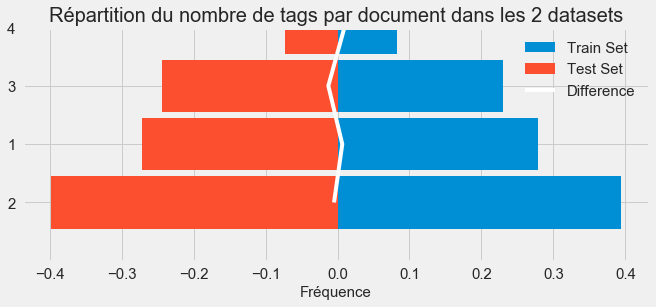

In [37]:
plt.style.use('fivethirtyeight')
fig, ax = plt.subplots(figsize=(10, 4))
train_barh = ax.barh(np.arange(len(y_train_freq)), y_train_freq,
                     0.9, label="Train Set", linewidth=0, align='center')
test_barh = ax.barh(np.arange(len(y_test_freq)), y_test_freq,
                    0.9, label="Test Set", linewidth=0, align='center')
diff_line, = ax.plot(diff, np.arange(len(y_test_freq)),
                     'y', linewidth=4, c='white')
ax.set_title(
    "Répartition du nombre de tags par document dans les 2 datasets", fontsize=20)
plt.yticks(np.arange(len(labels)), labels, fontsize=15)
plt.ylim(-1, 3)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15)
ax.set_xlabel("Fréquence", fontsize=15)
ax.legend((train_barh[0], test_barh[0], diff_line),
          ('Train Set', 'Test Set', 'Difference'), fontsize=15)
plt.show()

In [38]:
from collections import Counter
# Répartition des tags dans les 2 datasets
y_train_count = Counter(x for y in multilabel_binarizer.inverse_transform(
    y_train_bodytitle) for x in y)
y_test_count = Counter(
    x for y in multilabel_binarizer.inverse_transform(y_test_bodytitle) for x in y)
y_train_freq = [x[1]/sum(x[1] for x in sorted(y_train_count.most_common()[:-101:-1]))
                for x in sorted(y_train_count.most_common()[:-101:-1])]
y_test_freq = [-x[1]/sum(x[1] for x in sorted(y_test_count.most_common()[:-101:-1]))
               for x in sorted(y_test_count.most_common()[:-101:-1])]

c:\program files\python37\lib\site-packages\ipykernel_launcher.py:15: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.
  from ipykernel import kernelapp as app


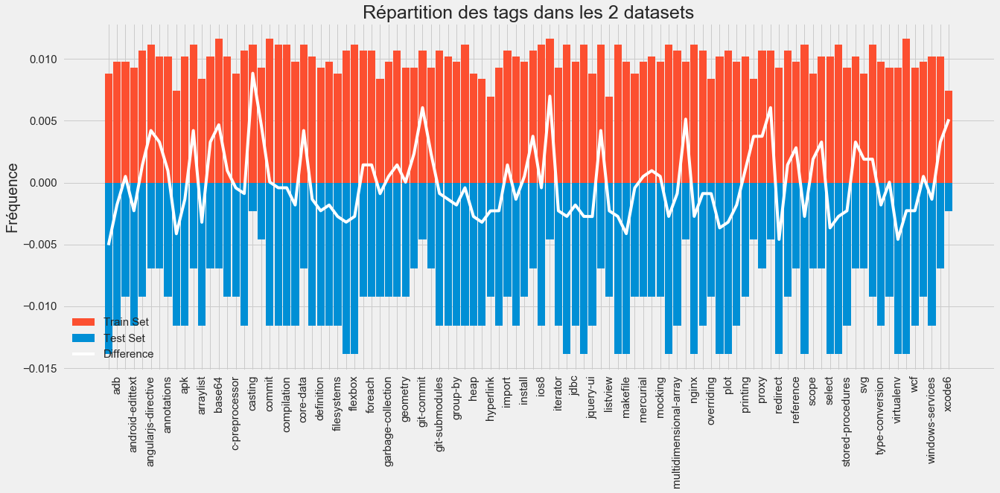

In [39]:
diff = [x + y for x, y in zip(y_train_freq, y_test_freq)]
labels = [x[0] for x in sorted(y_train_count.most_common()[:-101:-1])]
plt.style.use('fivethirtyeight')
fig, ax = plt.subplots(figsize=(20, 8))
test_bar = ax.bar(np.arange(len(y_test_freq)), y_test_freq,
                  0.9, label="Test Set", linewidth=0, align='center')
train_bar = ax.bar(np.arange(len(y_train_freq)), y_train_freq,
                   0.9, label="Train Set", linewidth=0, align='center')
diff_line, = ax.plot(np.arange(len(y_test_freq)),
                     diff, 'y', linewidth=4, c='white')
ax.set_title("Répartition des tags dans les 2 datasets", fontsize=25)
plt.xticks(np.arange(len(labels)), labels, fontsize=15, rotation=90)
for label in ax.xaxis.get_ticklabels()[::2]:
    label.set_visible(False)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15)
ax.set_ylabel("Fréquence", fontsize=20)
ax.legend((train_bar[0], test_bar[0], diff_line),
          ('Train Set', 'Test Set', 'Difference'), fontsize=15)
plt.show()

In [40]:
def n_tags_by_labels(data, data_label):
    import matplotlib.pyplot as plt
    # Nombre de tags par document
    y_n_tags = np.sum(data, axis=1)
    # Fréquence du nombre de tags par document
    import collections
    multiLabel_counts = collections.Counter(y_n_tags)
    # clés
    # print([x[0] for x in multiLabel_counts.most_common()])
    # valeurs
    # print([x[1] for x in multiLabel_counts.most_common()])
    plt.figure(figsize=(15, 5))
    ax = sns.barplot([x[0] for x in multiLabel_counts.most_common()], [
                     x[1] for x in multiLabel_counts.most_common()])
    plt.title("Questions having multiple tags : {}".format(
        data_label), fontsize=20)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.ylabel('Number of questions', fontsize=18)
    plt.xlabel('Number of tags', fontsize=18)
    # adding the text labels
    rects = ax.patches
    labels = [x[1] for x in multiLabel_counts.most_common()] / np.sum([x[1]
                                                                       for x in multiLabel_counts.most_common()])
    labels = ["{:0.1%}".format(x) for x in labels]
    for rect, label in zip(rects, labels):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height + 5,
                label, ha='center', va='bottom', fontsize=15)
    plt.style.use('fivethirtyeight')
    return

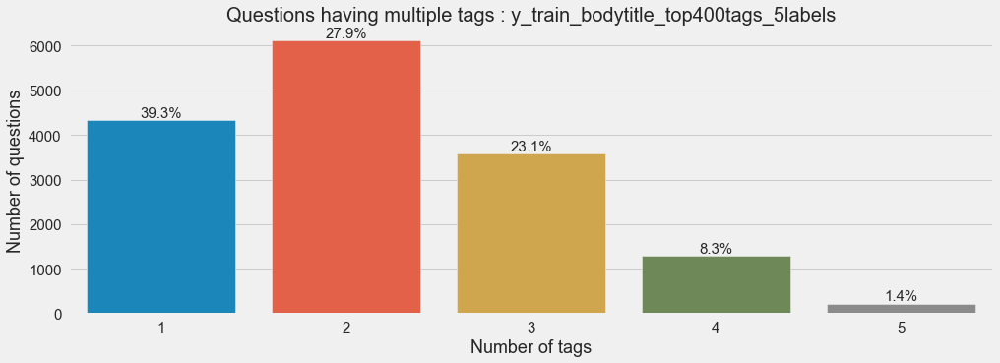

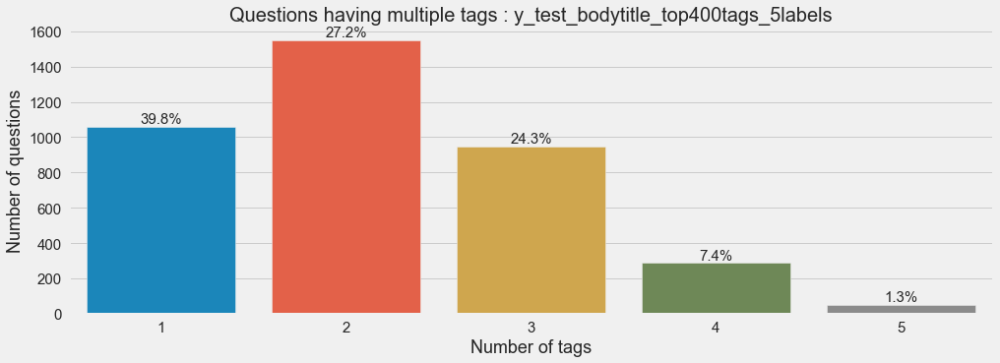

In [41]:
n_tags_by_labels(y_train_bodytitle, 'y_train_bodytitle_top400tags_5labels')
n_tags_by_labels(y_test_bodytitle, 'y_test_bodytitle_top400tags_5labels')

# Unsupervised models using LDA

In [42]:
def print_top_words(model, feature_names, n_top_words, data):
    ''' It shows the top words from the different clusters of a model

    Parameters:

    model: model 
    feature_names: different words to show 
    n_top_words (int): number of words to print for each feature 
    data: data for the model
    '''

    list_topics = []
    list_occurences = []
    n_topics = model.n_components

    for i in model.transform(data):
        list_topics.append(i.argmax())

    for topic in range(n_topics):
        list_occurences.append(list_topics.count(topic))

    top_topics = sorted(range(len(list_occurences)),
                        key=lambda k: list_occurences[k], reverse=True)

    for topic_idx, topic_id in zip(range(1, n_topics + 1), top_topics):
        message = "Tag #%d: " % topic_idx
        message += " / ".join([feature_names[i]
                               for i in model.components_[topic_id].argsort()[:-n_top_words - 1:-1]])
        print(message)

    print()

In [43]:
def lda(vectorizer, data_train, data_test):
    ''' Showing the perplexity score for several LDA models with different values
    for n_components parameter, and printing the top words for the best LDA model
    (the one with the lowest perplexity)

    Parameters:

    vectorizer: TF-IDF convertizer                                              
    data_train: data to fit the model with
    data_test: data to test
    '''

    # number of topics
    n_top_words = 5
    best_perplexity = np.inf
    best_lda = 0
    perplexity_list = []
    n_topics_list = []
    print("Extracting term frequency features for LDA...")

    for n_topics in np.linspace(10, 50, 5, dtype='int'):
        lda_model = LatentDirichletAllocation(n_components=n_topics, max_iter=5,
                                              learning_method='online',
                                              learning_offset=50.,
                                              random_state=0).fit(data_train)
        n_topics_list.append(n_topics)
        perplexity = lda_model.perplexity(data_test)
        perplexity_list.append(perplexity)

        # Perplexity is defined as exp(-1. * log-likelihood per word)
        # Perplexity: The smaller the better
        if perplexity <= best_perplexity:
            best_perplexity = perplexity
            best_lda = lda_model

    plt.title("Evolution of perplexity score depending on number of topics")
    plt.xlabel("Number of topics")
    plt.ylabel("Perplexity")
    plt.plot(n_topics_list, perplexity_list)
    plt.show()

    print("\n The tags in the LDA model :")
    tf_feature_names = vectorizer.get_feature_names()
    print_top_words(best_lda, tf_feature_names, n_top_words, data_test)

Extracting term frequency features for LDA...


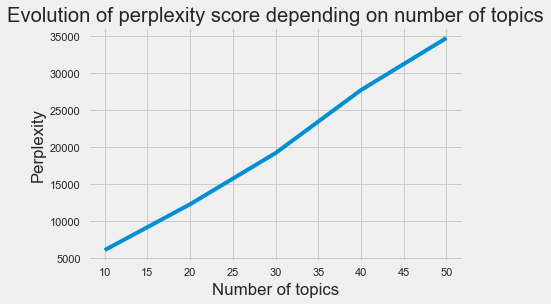


 The tags in the LDA model :
Tag #1: error / application / project / user / server
Tag #2: value / list / table / name / array
Tag #3: html / jquery / text / css / page
Tag #4: difference / java / object / date / static
Tag #5: git / branch / commit / repository / change
Tag #6: line / python / command / bash / mysql
Tag #7: image / android / device / screen / iphone
Tag #8: android / bar / const / foo / studio
Tag #9: view / swift / ios / cell / uiview
Tag #10: json / spring / package / xml / install



In [44]:
# LDA model (BOW) for Text field

lda(vectorizer_dfText, X_tfidf_train_bodytitle, X_tfidf_test_bodytitle)

In [45]:
best_lda = LatentDirichletAllocation(n_components=10, max_iter=5,
                                     learning_method='online',
                                     learning_offset=50.,
                                     random_state=0).fit(X_tfidf_train_bodytitle)

pyLDAvis.enable_notebook()
panel = pyLDAvis.sklearn.prepare(
    best_lda, X_tfidf_test_bodytitle, vectorizer_dfText, mds='tsne')
panel

PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
0      32.420952   8.115230       1        1  37.411912
3       0.648955  71.707100       2        1  21.802242
1      71.019684   9.971006       3        1   8.586045
9       3.785981  33.185135       4        1   6.554708
2     -42.666500  -9.222070       5        1   5.936561
7      -3.621689 -43.526516       6        1   5.196994
8      -3.632402  -4.171708       7        1   3.902151
4     -36.584400  35.804413       8        1   3.791095
6      44.391380  50.615383       9        1   3.691517
5      40.235809 -31.591665      10        1   3.126775, topic_info=             Term       Freq      Total Category  logprob  loglift
670           git  94.000000  94.000000  Default  30.0000  30.0000
52        android  98.000000  98.000000  Default  29.0000  29.0000
759         image  73.000000  73.000000  Default  28.0000  28.0000
436    difference  76.000000  76.000000  Default  27.0000  27.0000
844          json  42.000000  42.000000  Default  26.0000  26.0000
...           ...        ...        ...      ...      ...      ...
946           map   6.617448  13.786689  Topic10  -4.0125   2.7312
815   interpreter   1.567272   3.560821  Topic10  -5.4529   2.6445
1512     standard   1.573218   4.986942  Topic10  -5.4491   2.3115
642     framework   3.899066  16.985678  Topic10  -4.5415   1.9935
1737      version   2.900429  37.721444  Topic10  -4.8373   0.8998

[538 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
0         8  0.988320            11
1         1  0.203884             8
1         8  0.815537             8
6         5  1.026546  accidentally
12        1  0.454842        action
...     ...       ...           ...
1802      1  0.136472           xml
1802      2  0.068236           xml
1802      8  0.136472           xml
1802     10  0.648240           xml
1811      4  0.930437          zone

[934 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 4, 2, 10, 3, 8, 9, 5, 7, 6])

In [37]:
# matrice TF
n_topics_list = [10, 15, 20, 25, 30]
perplexity_list = []
lda_model_list = []

for n_topics in n_topics_list:
    print("Training LDA for n_topics = {}".format(n_topics))
    lda_model = LatentDirichletAllocation(  # learning_method='online',
        n_components=n_topics,
        max_iter=5,
        random_state=42,
        n_jobs=-1).fit(X_tfidf_train_bodytitle)

    perplexity = lda_model.perplexity(X_tfidf_test_bodytitle)
    perplexity_list.append(perplexity)
    lda_model_list.append(lda_model)
    print("Perplexity = {} for n_topics = {}".format(perplexity, n_topics))

Training LDA for n_topics = 10
Perplexity = 11615.000207677811 for n_topics = 10
Training LDA for n_topics = 15
Perplexity = 28858.773733126498 for n_topics = 15
Training LDA for n_topics = 20
Perplexity = 59620.976987710026 for n_topics = 20
Training LDA for n_topics = 25
Perplexity = 129314.73570100976 for n_topics = 25
Training LDA for n_topics = 30
Perplexity = 254073.69969101698 for n_topics = 30


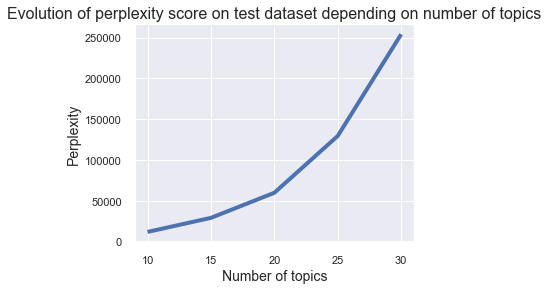

In [38]:
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)
fig, ax = plt.subplots(figsize=(5, 4))
plt.style.use('fivethirtyeight')
plt.title("Evolution of perplexity score on test dataset depending on number of topics", fontsize=16)
plt.xlabel("Number of topics", fontsize=14)
plt.ylabel("Perplexity", fontsize=14)
ax.xaxis.set_major_locator(MultipleLocator(5))
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.plot(n_topics_list, perplexity_list)
plt.show()

In [39]:
def topics_analysis(lda_model, n_topics, vectorizer, data_vectorized, data_ori):

    # Create Document - Topic Matrix
    lda_output = lda_model.transform(data_vectorized)

    # column names
    topicnames = ["Topic" + str(i) for i in range(n_topics)]

    # index names
    docnames = ["Doc" + str(i) for i in range(len(data_ori))]

    # Make the pandas dataframe
    df_document_topic = pd.DataFrame(
        np.round(lda_output, 2), columns=topicnames, index=docnames)

    # Get dominant topic for each document
    dominant_topic = np.argmax(df_document_topic.values, axis=1)
    df_document_topic['dominant_topic'] = dominant_topic

    # Styling
    def color_green(val):
        color = 'green' if val > .1 else 'black'
        return 'color: {col}'.format(col=color)

    def make_bold(val):
        weight = 700 if val > .1 else 400
        return 'font-weight: {weight}'.format(weight=weight)

    # Apply Style
    df_document_topics = df_document_topic.head(
        15).style.applymap(color_green).applymap(make_bold)
    #print('n_topics = {} : dominant topic in a sample of documents'.format(n_topics))
    # display(df_document_topics)

    df_topic_distribution = df_document_topic['dominant_topic'].value_counts(
    ).reset_index(name="N Documents")
    df_topic_distribution.columns = ['Topic Num', 'N Documents']

    # topics distribution across documents
    plt.style.use('fivethirtyeight')
    fig, ax = plt.subplots(figsize=(16, 6))
    plt.bar(df_topic_distribution['Topic Num'],
            df_topic_distribution['N Documents'])
    plt.xticks(df_topic_distribution['Topic Num'],
               rotation='vertical', fontsize=14)
    plt.ylabel("Occurrences", fontsize=14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(11)
    plt.title('n_topics = {} : topics distribution across documents on test dataset'.format(
        n_topics), fontsize=16)
    plt.show()

    #inv_specialtags = {v: k for k, v in dict(specialtags).items()}
    words_label = []
    for word in vectorizer.get_feature_names():
        # if word in inv_specialtags.keys():
        #    words_label.append(inv_specialtags[word])
        # else:
        words_label.append(word)

    # Show top n keywords for each topic
    top_words = 5
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:top_words]
        topic_keywords.append(np.array(words_label).take(top_keyword_locs))

    df_topic_keywords = pd.DataFrame(topic_keywords)
    df_topic_keywords.columns = [
        'Word '+str(i) for i in range(df_topic_keywords.shape[1])]
    df_topic_keywords.index = [
        'Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
    print('n_topics = {} : Top {} words for each topic on test dataset'.format(
        n_topics, top_words))
    display(df_topic_keywords)

    # words cloud
    from wordcloud import WordCloud
    for id_topic in range(n_topics):
        topic_weights = lda_model.components_[id_topic]
        topic_words_weights = [words_label[i]
                               for i in topic_weights.argsort()[:-50 - 1:-1]]
        wc = WordCloud(background_color='white').generate(
            " ".join(topic_words_weights))
        plt.style.use('seaborn')
        plt.figure(figsize=(12, 8))
        plt.imshow(wc, interpolation="bilinear")
        plt.title('n_topics = {} and id_topic = {} : 50 words cloud on test dataset'.format(
            n_topics, id_topic), fontsize=16)
        plt.axis('off')

    return

c:\program files\python37\lib\site-packages\ipykernel_launcher.py:48: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.


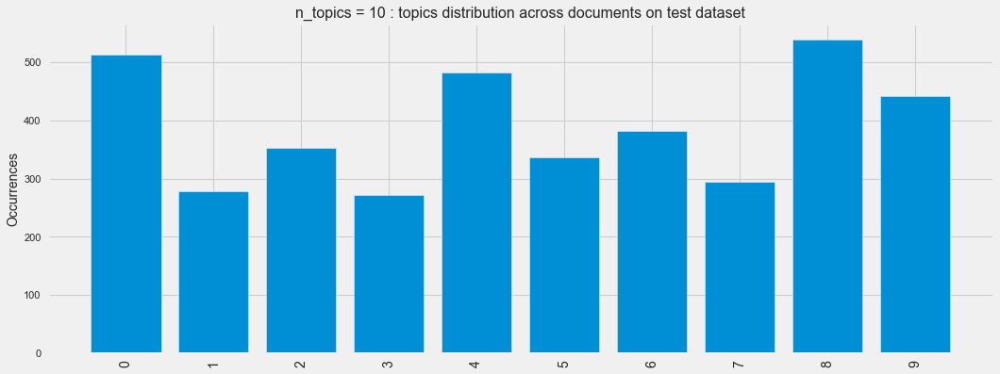

n_topics = 10 : Top 5 words for each topic on test dataset


,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,html,text,jquery,input,select
Topic 1,git,branch,commit,repository,github
Topic 2,image,mysql,database,size,height
Topic 3,directory,date,bash,command,line
Topic 4,object,array,javascript,exception,error
Topic 5,list,java,value,integer,vim
Topic 6,json,request,http,server,error
Topic 7,android,table,null,name,activity
Topic 8,project,difference,net,windows,error
Topic 9,python,number,static,algorithm,language


c:\program files\python37\lib\importlib\_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
c:\program files\python37\lib\site-packages\wordcloud\wordcloud.py:31: ResourceWarning: unclosed file <_io.TextIOWrapper name='c:\\program files\\python37\\lib\\site-packages\\wordcloud\\stopwords' mode='r' encoding='cp1252'>
  STOPWORDS = set(map(str.strip, open(os.path.join(FILE, 'stopwords')).readlines()))
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:48: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.


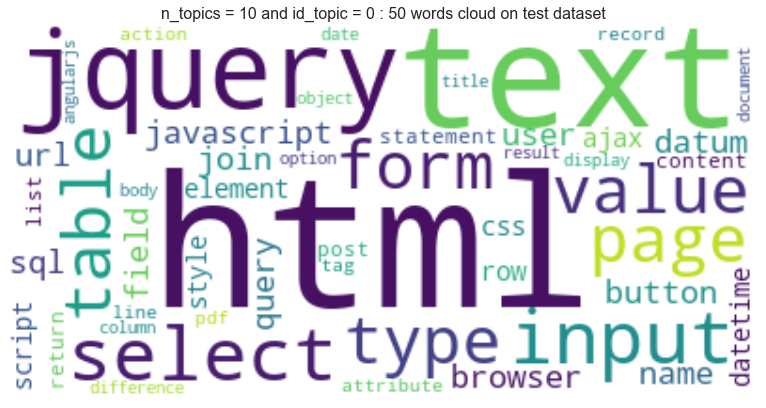

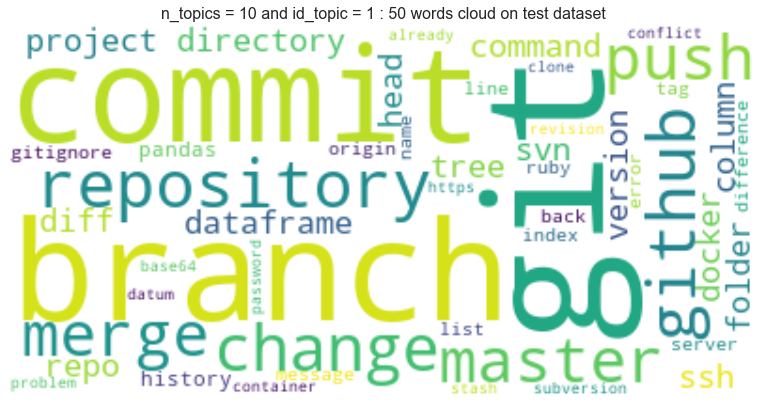

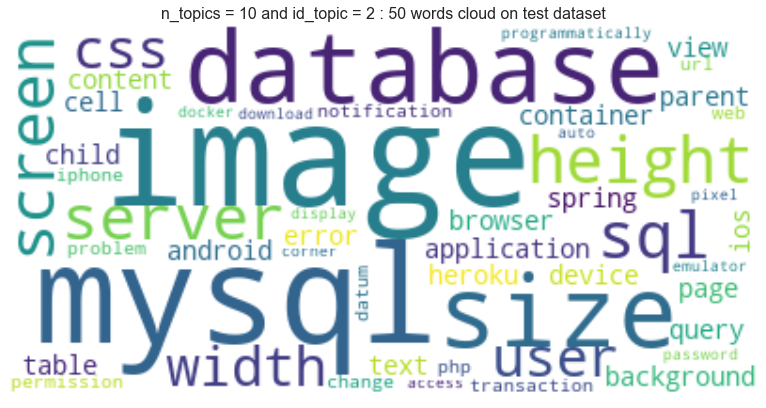

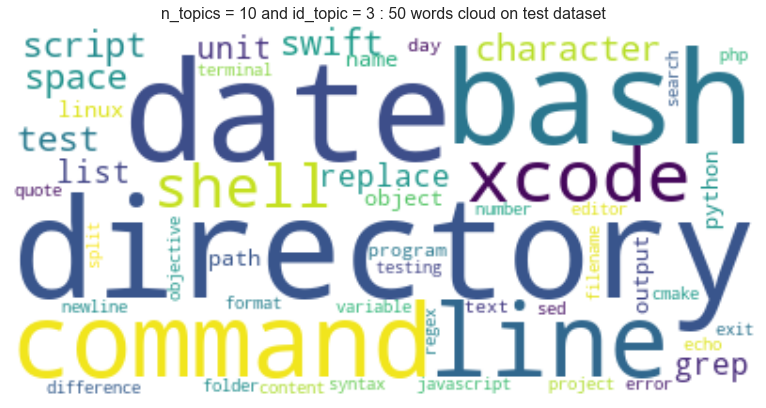

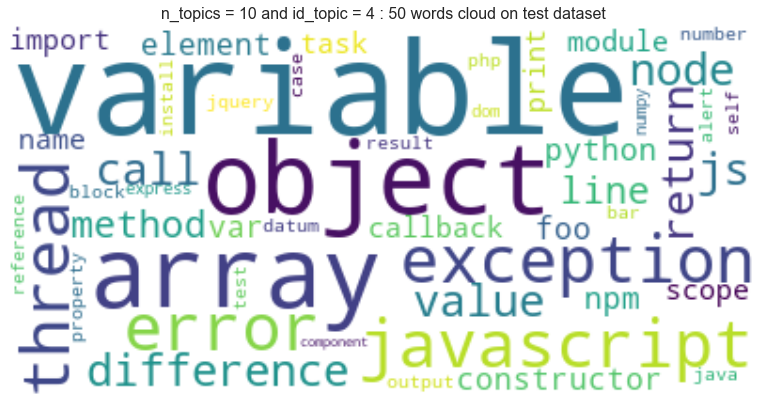

...

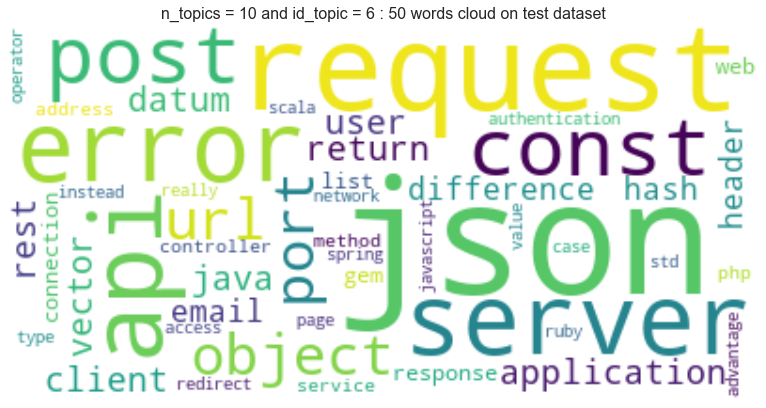

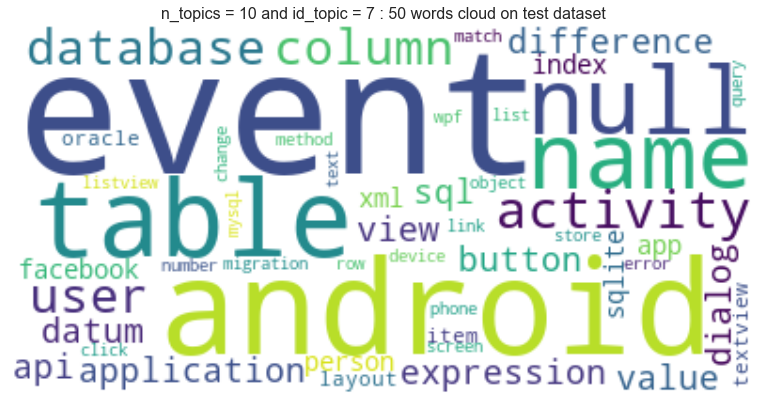

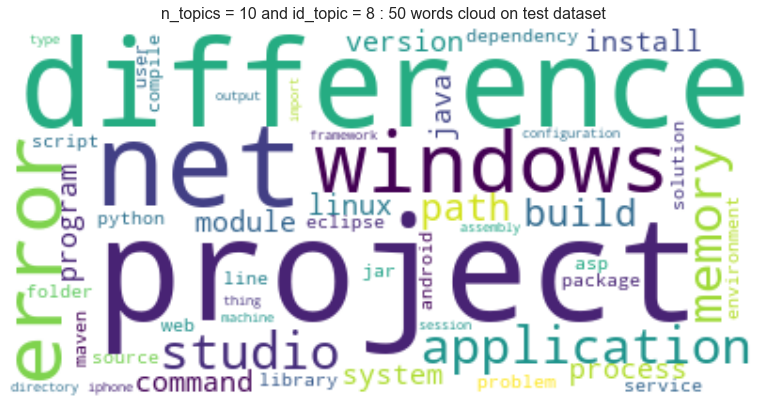

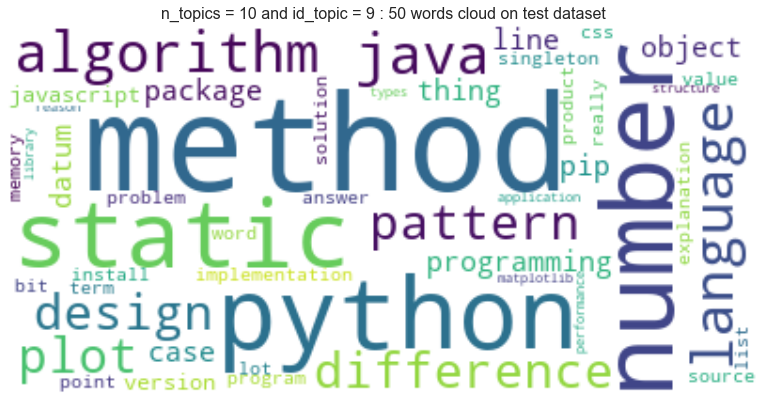

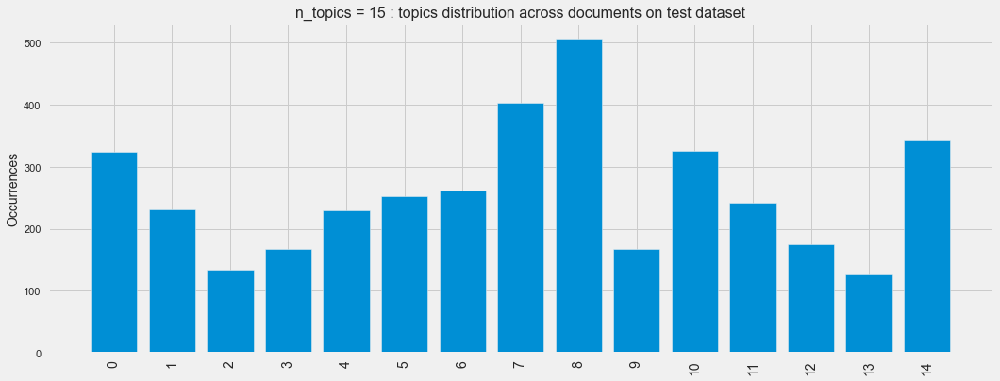

n_topics = 15 : Top 5 words for each topic on test dataset


,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,text,input,html,jquery,page
Topic 1,git,repository,mysql,commit,github
Topic 2,image,docker,install,container,path
Topic 3,branch,git,directory,master,scope
Topic 4,array,exception,line,element,xml
Topic 5,java,php,vim,random,number
Topic 6,json,request,xcode,http,api
Topic 7,android,table,column,sql,database
Topic 8,project,error,import,build,application
Topic 9,python,number,algorithm,plot,pip


c:\program files\python37\lib\site-packages\ipykernel_launcher.py:48: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.


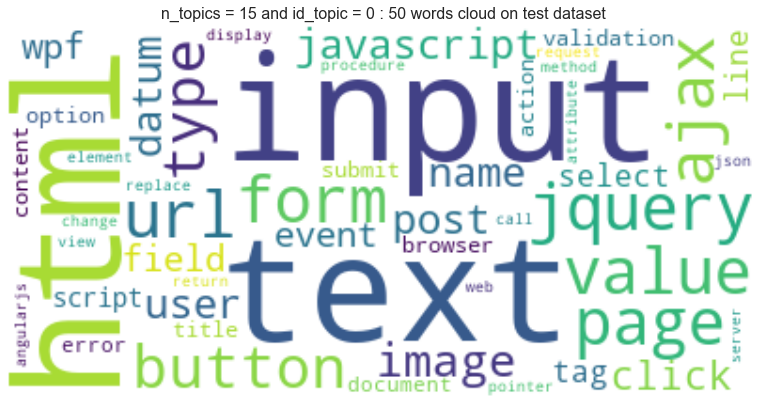

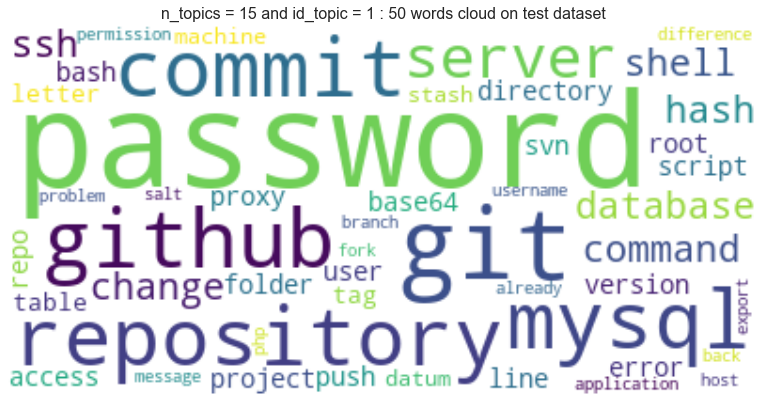

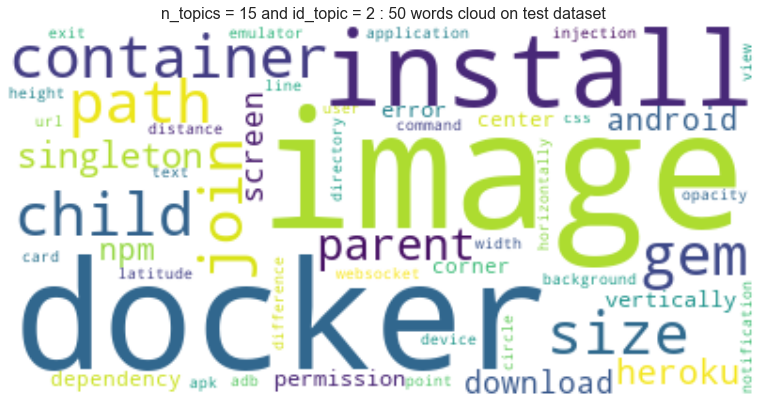

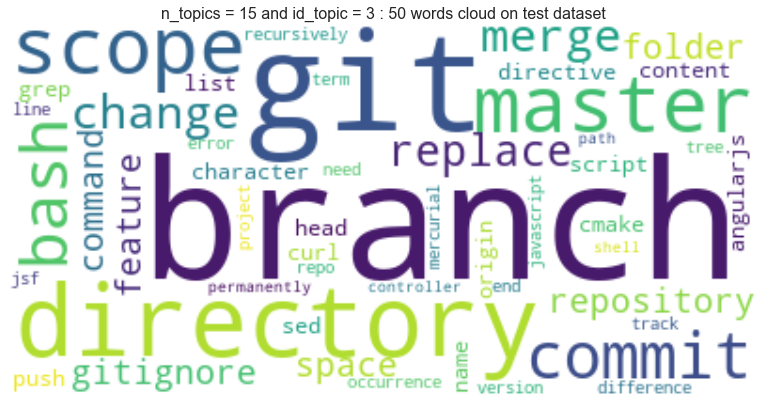

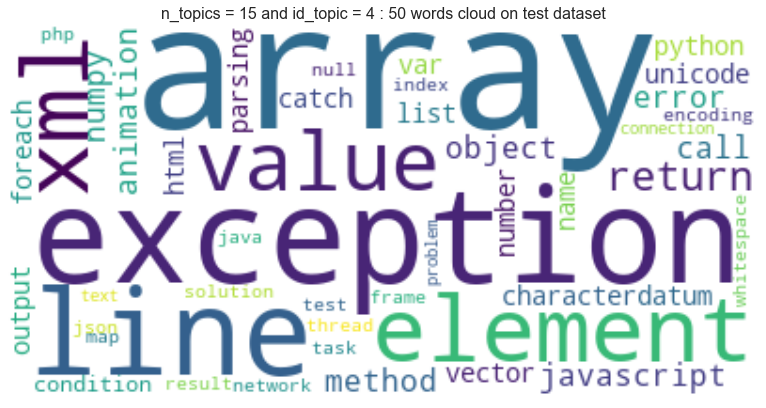

...

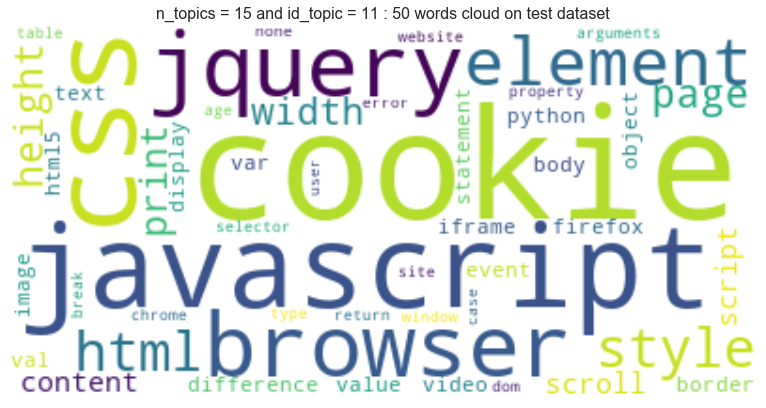

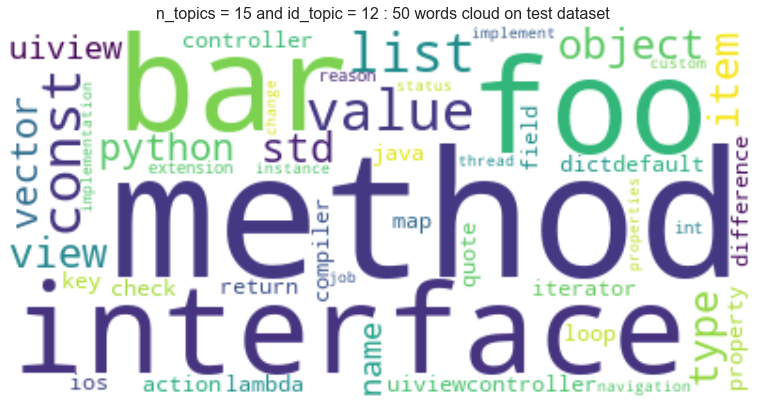

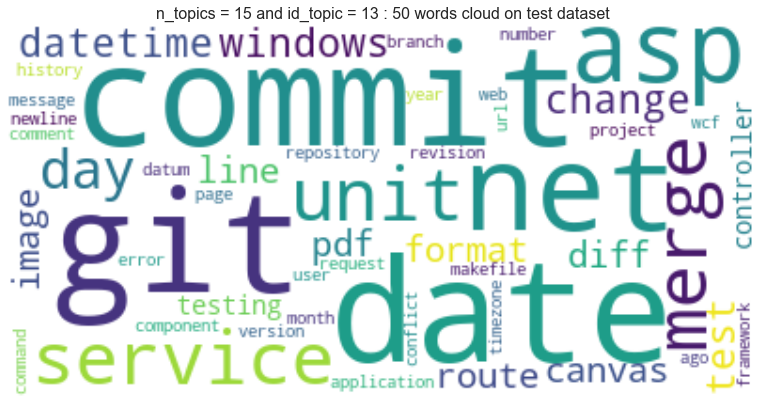

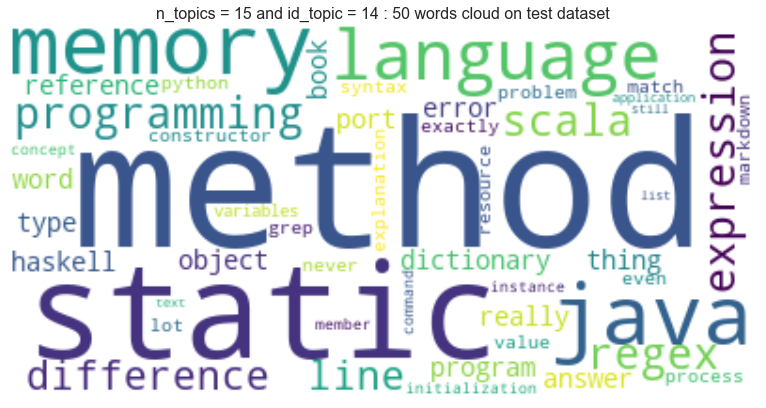

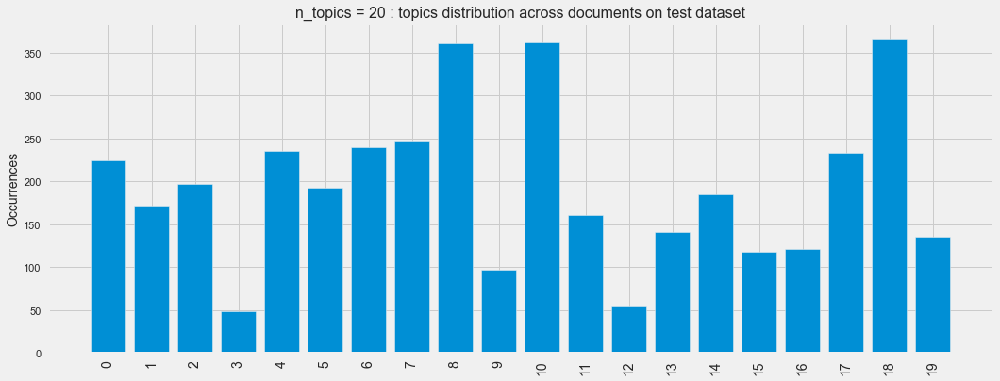

n_topics = 20 : Top 5 words for each topic on test dataset


,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,text,input,html,form,page
Topic 1,git,commit,repository,bash,github
Topic 2,table,database,mysql,sql,query
Topic 3,branch,uiview,git,image,space
Topic 4,array,jquery,element,exception,javascript
Topic 5,java,value,integer,random,list
Topic 6,json,request,post,http,url
Topic 7,android,activity,null,user,application
Topic 8,project,error,build,module,studio
Topic 9,number,algorithm,plot,pattern,python


c:\program files\python37\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:48: PendingDeprecationWarning: 
The label function will be deprecated in a future version. Use Tick.label1 instead.


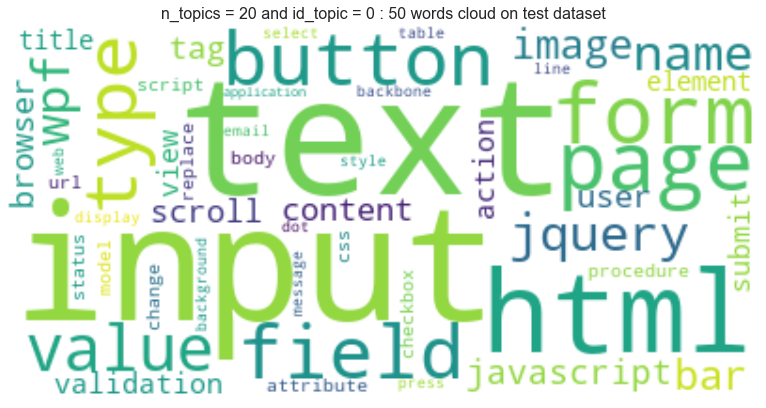

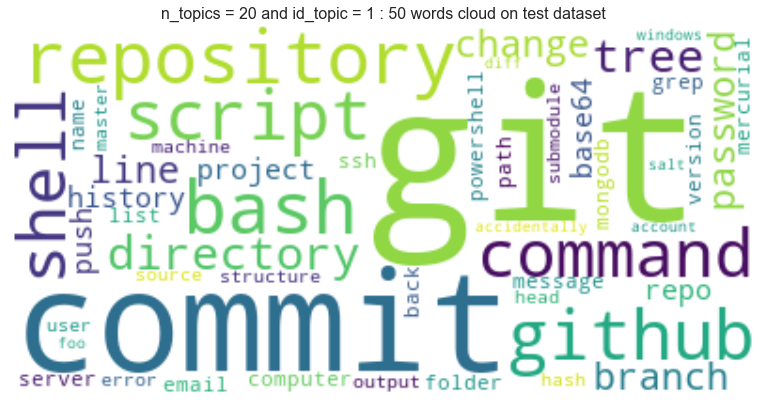

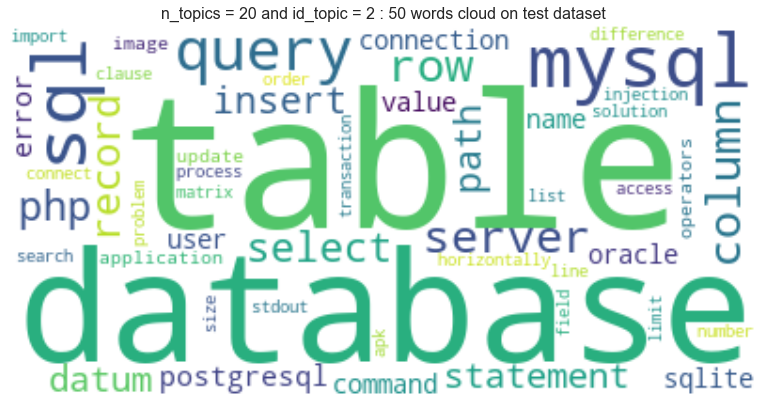

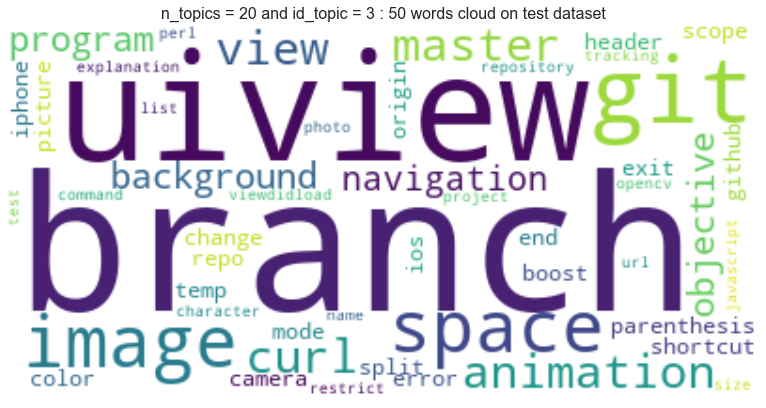

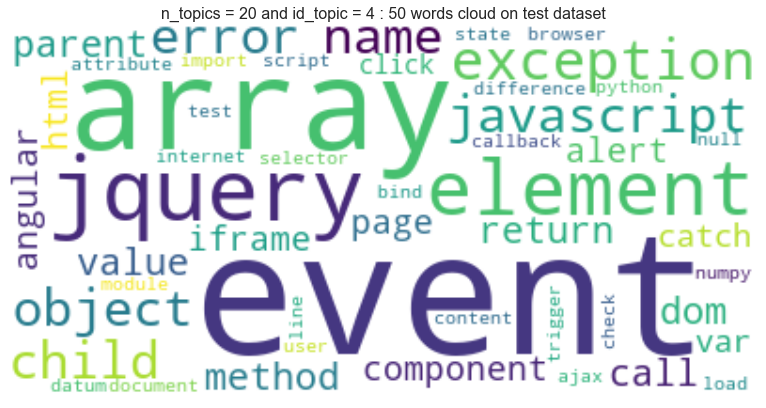

...

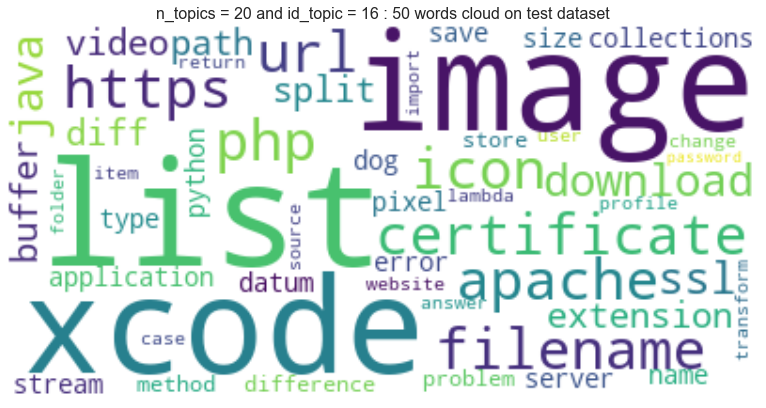

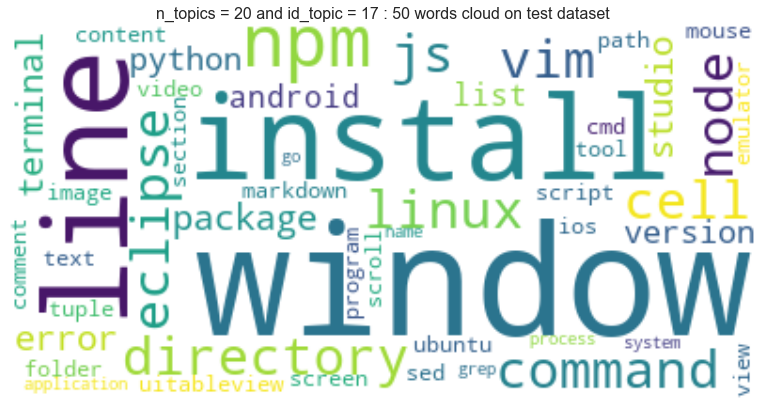

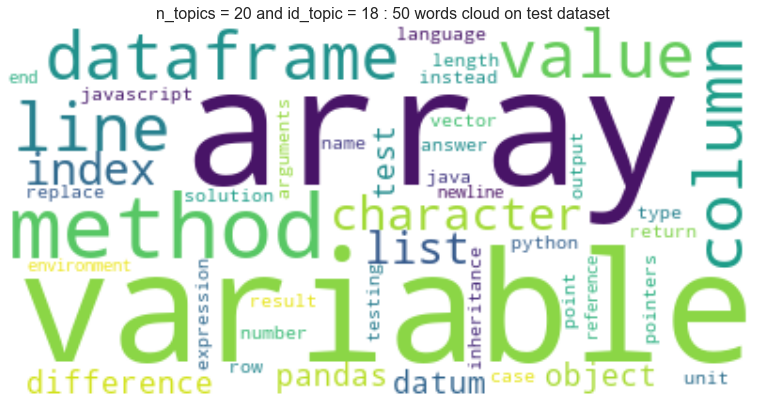

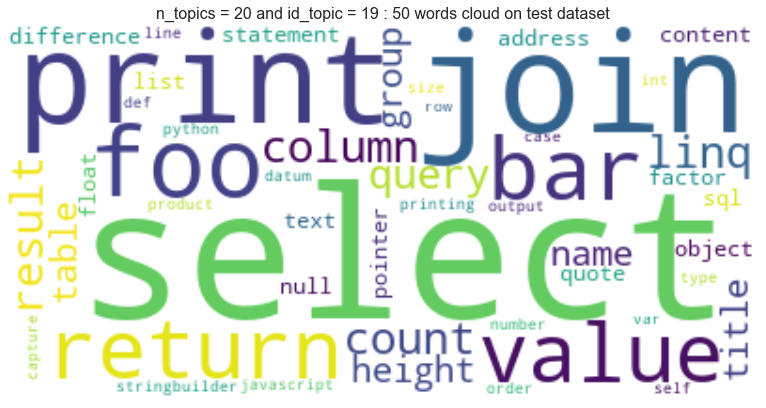

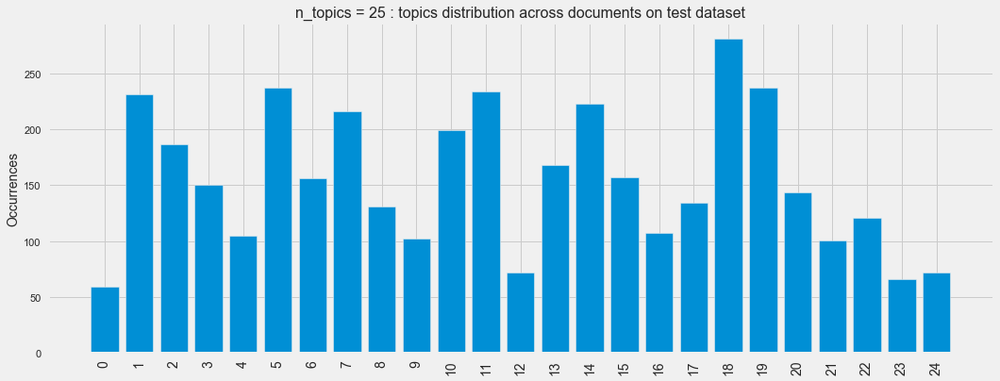

n_topics = 25 : Top 5 words for each topic on test dataset


,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,join,const,input,scope,markdown
Topic 1,git,commit,branch,repository,github
Topic 2,mysql,database,server,sql,node
Topic 3,character,program,space,gcc,curl
Topic 4,xml,spring,plot,method,python
Topic 5,integer,random,number,java,php
Topic 6,xcode,ios,iphone,swift,error
Topic 7,api,activity,rest,android,application
Topic 8,shell,command,directory,script,csv
Topic 9,python,number,pattern,install,algorithm


c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max

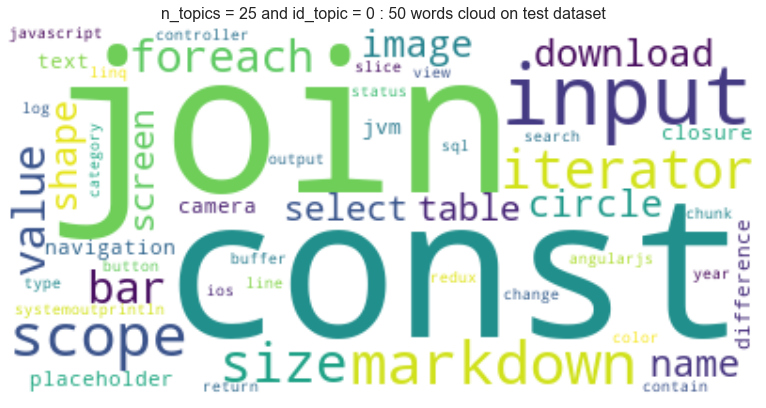

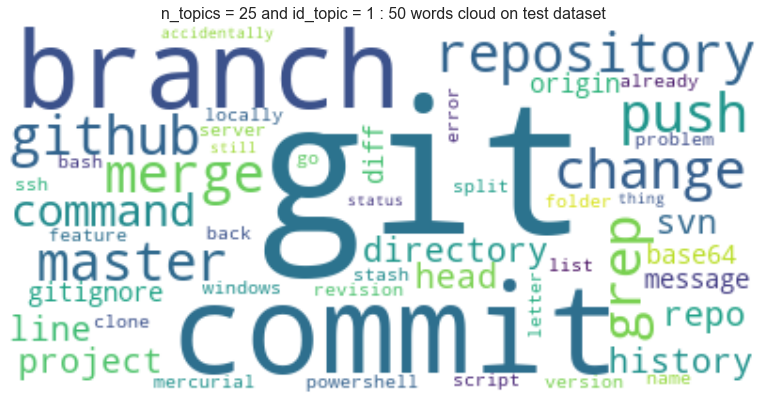

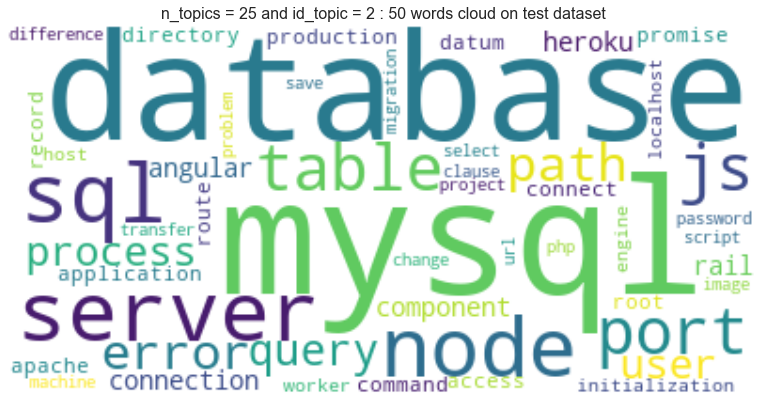

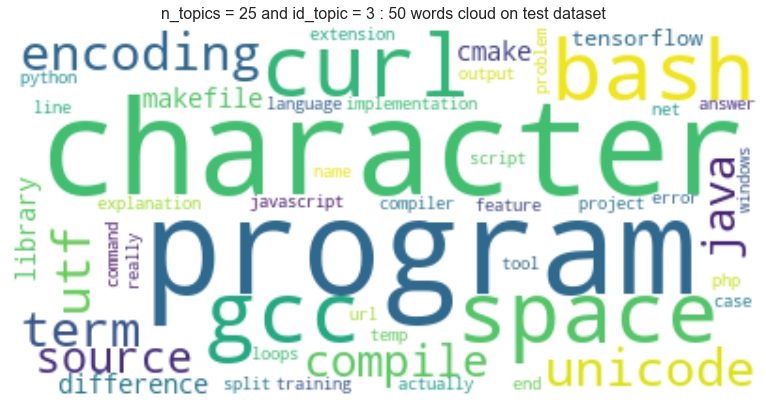

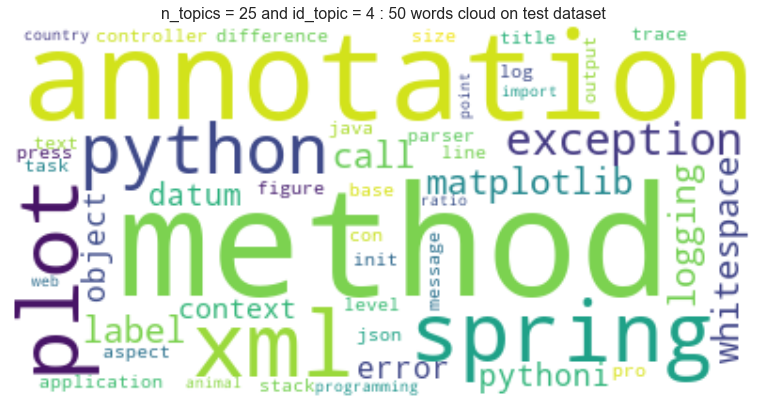

...

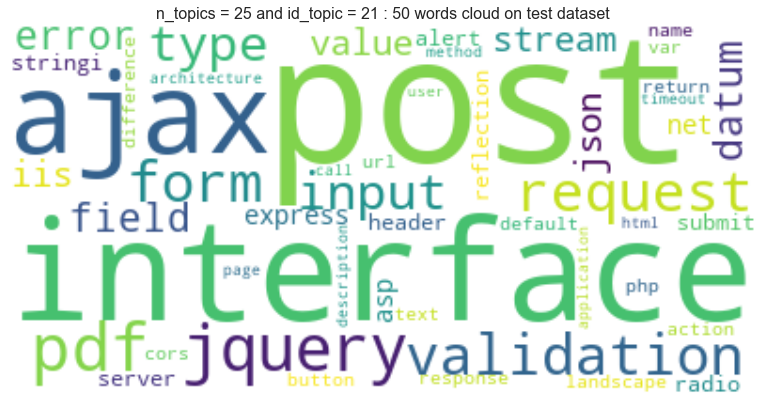

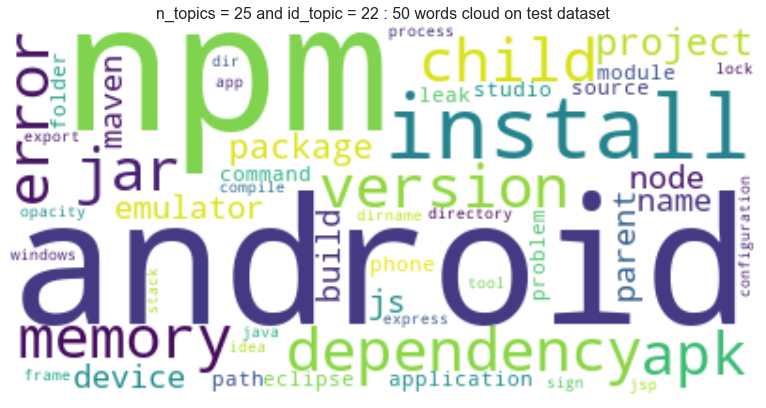

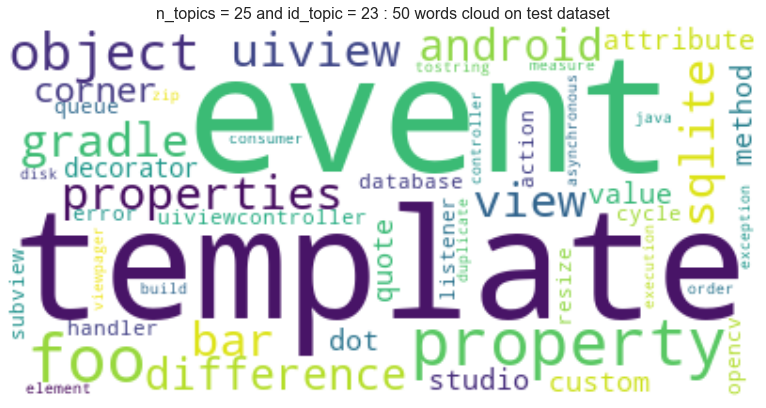

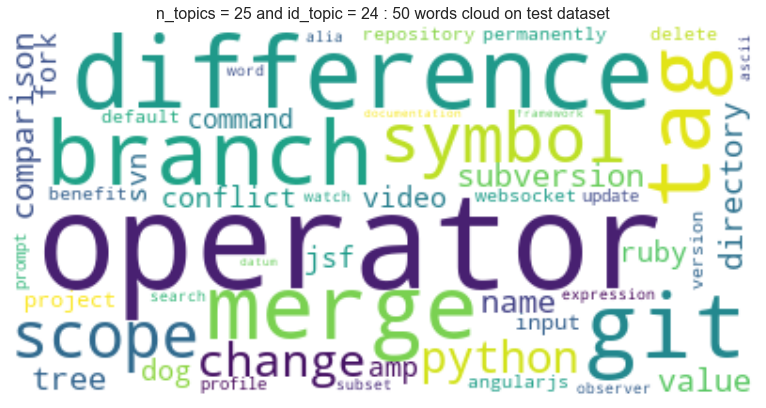

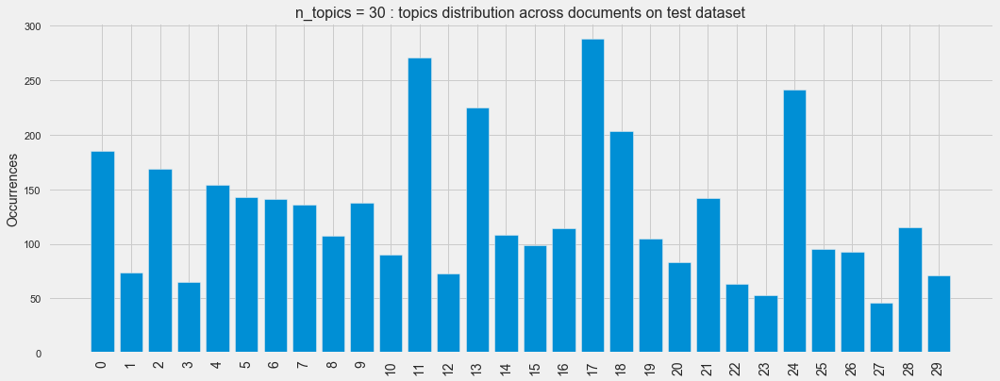

n_topics = 30 : Top 5 words for each topic on test dataset


,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,input,form,type,field,value
Topic 1,bash,script,shell,net,hash
Topic 2,mysql,node,js,child,server
Topic 3,xcode,space,integer,operator,ios
Topic 4,array,exception,arrays,object,xml
Topic 5,color,random,scala,tab,import
Topic 6,json,spring,email,const,application
Topic 7,null,android,assembly,user,dialog
Topic 8,grep,process,line,csv,unix
Topic 9,algorithm,number,pip,wpf,canvas


c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
c:\program files\python37\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max

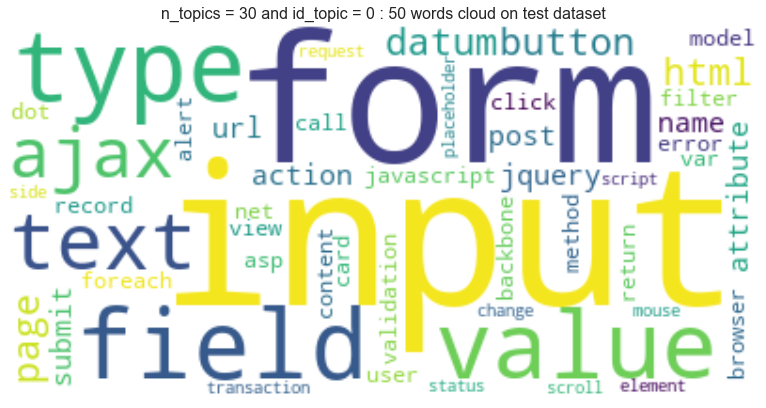

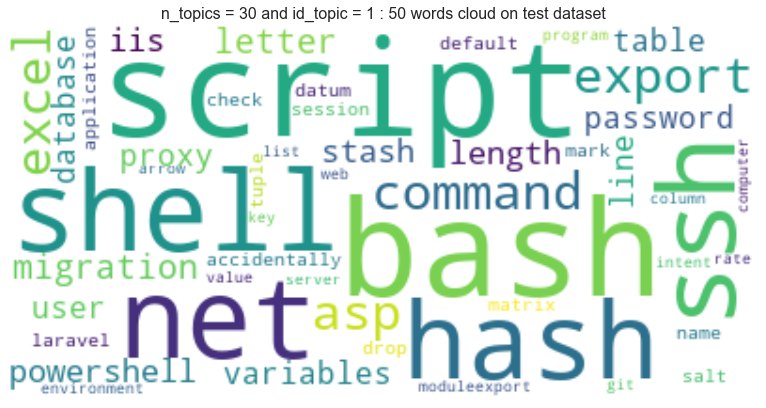

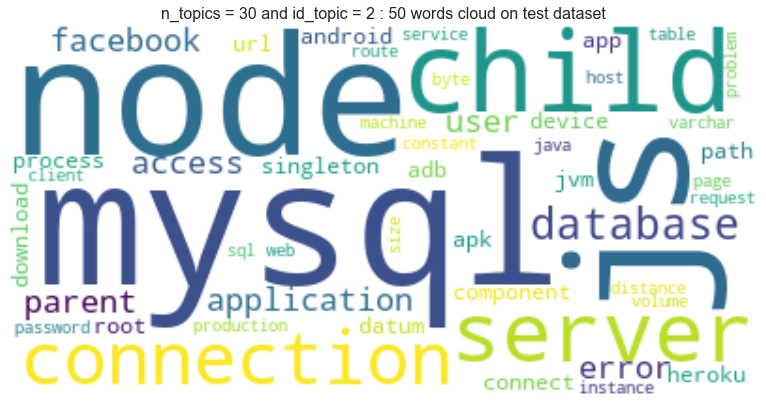

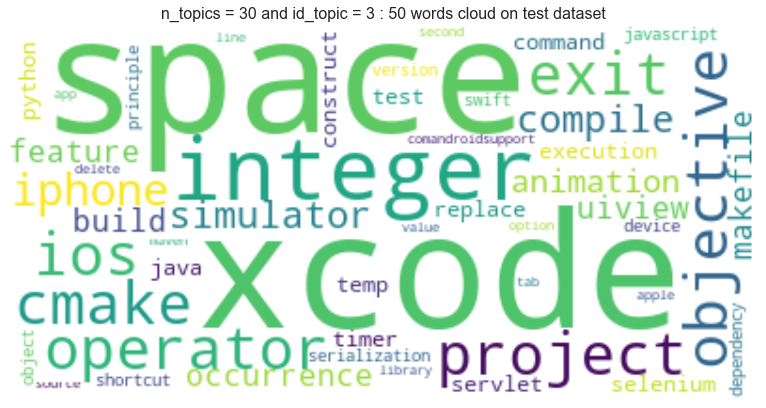

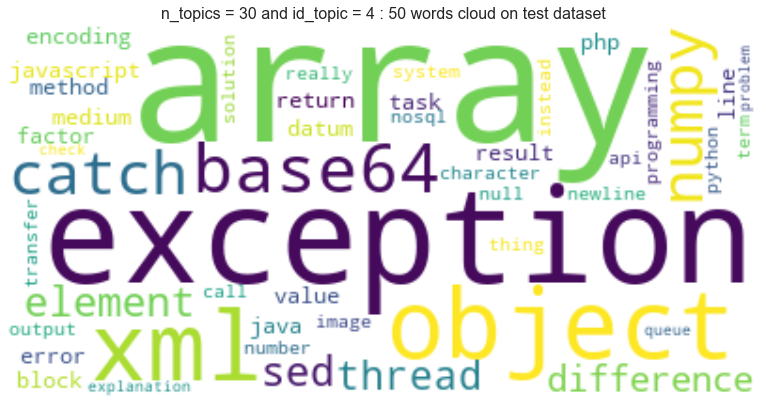

...

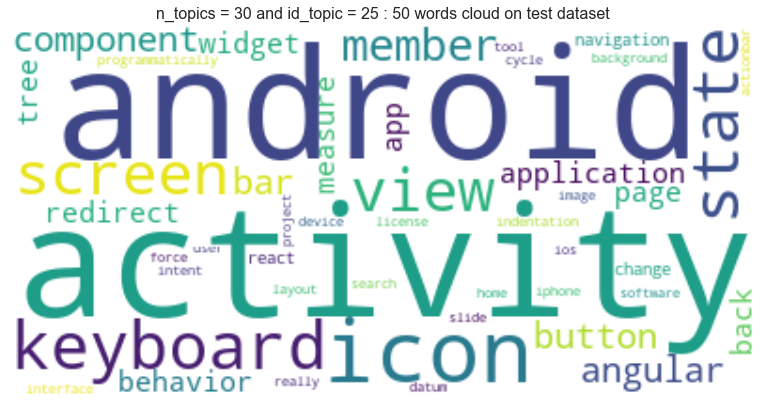

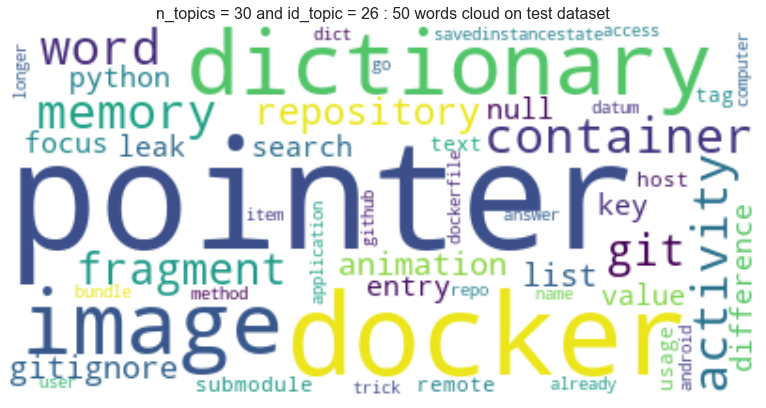

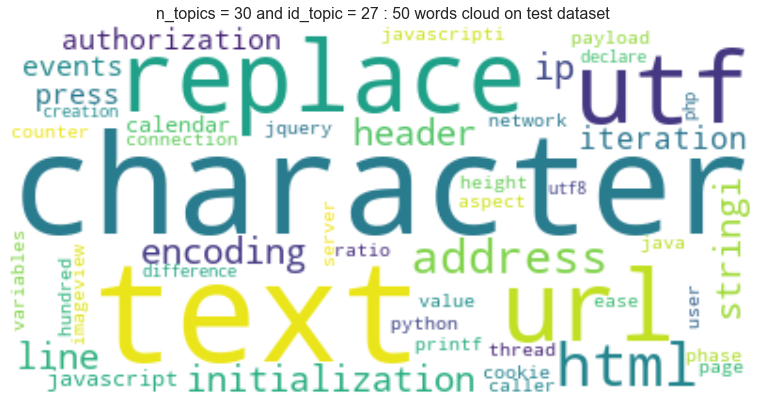

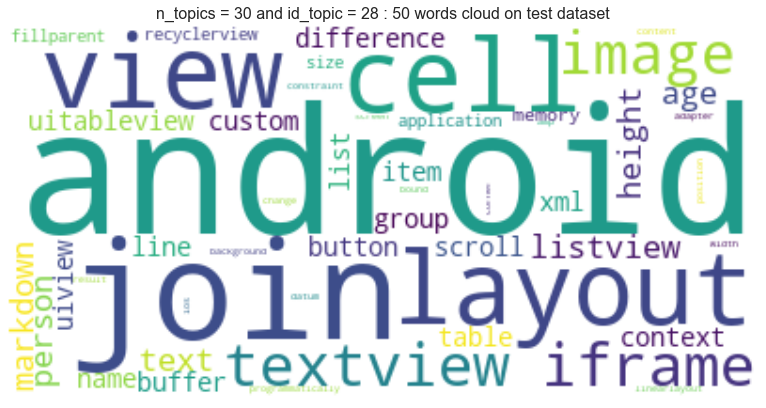

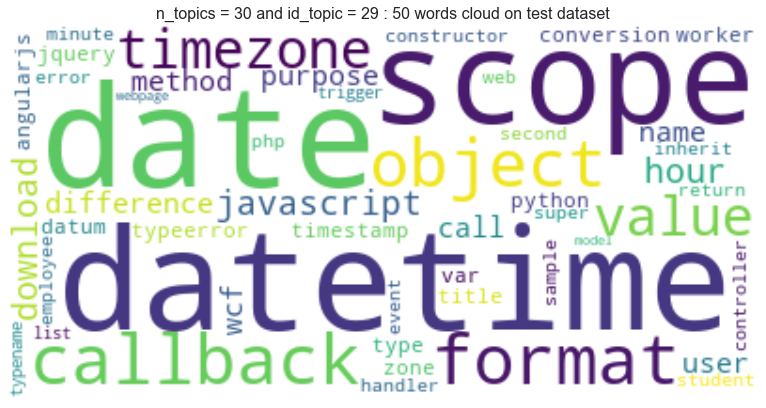

In [40]:
for idx, n_topics in enumerate(n_topics_list):
    topics_analysis(lda_model_list[idx], n_topics, vectorizer_dfText,
                    X_tfidf_test_bodytitle, X_test_bodytitle)

In [51]:
# Je choisis le LDA correspondant à n_topics = 15
for idx, n_topics in enumerate(n_topics_list):
    if n_topics==15:
        best_lda = lda_model_list[idx]
        print(best_lda)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=5,
                          mean_change_tol=0.001, n_components=15, n_jobs=-1,
                          perp_tol=0.1, random_state=42, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)


In [78]:
# SAUVEGARDE
with open('lda_model.pkl', 'wb') as f:
    pickle.dump(best_lda, f)

In [42]:
def Recommend_tags_lda_test(X_tfidf_test, X_train, num_topics: int):
    ''' Recommendation system for stackoverflow posts based on a lda model, 
    it returns up to 5 tags.

    Parameters:

    X_tfidf_test: the stackoverflow posts after TF-IDF transformation
    X_train: data to fit the model with
    num_topics : number of topics
    '''

    df_tags_test_lda = pd.DataFrame(index=[i for i in range(X_tfidf_test.shape[0])],
                                    columns=['0.010', '0.011', '0.012', '0.013'])
    corpus = X_tfidf_test
    n_topics = num_topics

    vectorizer_text = TfidfVectorizer(analyzer='word', min_df=0.001, max_df=0.1,
                                      strip_accents=None, encoding='utf-8',
                                      preprocessor=None,
                                      # Need to repeat token pattern
                                      token_pattern=r'(?u)\b\w+\b',
                                      max_features=2000)
    X_tfidf_train = vectorizer_text.fit_transform(X_train)
    lda_model = LatentDirichletAllocation(n_components=n_topics, max_iter=5,
                                          learning_method='online',
                                          learning_offset=50.,
                                          random_state=0).fit(X_tfidf_train)
    corpus_projection = lda_model.transform(corpus)

    feature_names = vectorizer_text.get_feature_names()
    lda_components = lda_model.components_ / \
        lda_model.components_.sum(axis=1)[:, np.newaxis]  # normalization

    # threshold to exceed to be considered as a relevant tag
    for column, threshold in zip(range(4), [0.010, 0.011, 0.012, 0.013]):

        for text in range(corpus.shape[0]):
            list_scores = []
            list_words = []

            for topic in range(n_topics):
                topic_score = corpus_projection[text][topic]

                for (word_idx, word_score) in zip(lda_components[topic].argsort()[:-5:-1], sorted(lda_components[topic])[:-5:-1]):
                    score = topic_score*word_score

                    if score >= threshold:
                        list_scores.append(score)
                        list_words.append(feature_names[word_idx])

            results = [tag for (y, tag) in sorted(zip(list_scores, list_words),
                                                  key=lambda pair: pair[0], reverse=True)]
            # maximum five tags
            df_tags_test_lda.iloc[text, column] = results[:5]

    return df_tags_test_lda

In [43]:
df_tags_test_lda = Recommend_tags_lda_test(
    X_tfidf_test_bodytitle, X_train_bodytitle, 10)

In [44]:
df_tags_test_lda.head(20)

,0.010,0.011,0.012,0.013
0,[],[],[],[]
1,"[url, javascript, http, php]","[url, javascript, http, php]","[url, javascript, http, php]","[url, javascript, http, php]"
2,[git],[],[],[]
3,[],[],[],[]
4,"[line, python, error, command]","[line, python, error, command]",[line],[]
5,[foo],[],[],[]
6,[],[],[],[]
7,"[git, branch, commit, repository]","[git, branch, commit, repository]","[git, branch, commit, repository]","[git, branch, commit]"
8,"[git, branch, commit]","[git, branch]",[git],[git]
9,[],[],[],[]


In [45]:
median_tags = np.median(df['Tags'].apply(lambda x: len(x)))
mean_tags = np.mean(df['Tags'].apply(lambda x: len(x)))
print('Average number of tags in the training set: %.2f' % mean_tags)
print('Median number of tags in the training set: ', median_tags)
print('--------------------------------------')

for threshold in df_tags_test_lda.columns:
    print('Average number of tags in the test set, with a threshold of %s: %.2f'
          % (threshold, np.mean(df_tags_test_lda[threshold].apply(lambda x: len(x)))))
    print('Median number of tags in the test set, with a threshold of %s: %d' %
          (threshold, np.median(df_tags_test_lda[threshold].apply(lambda x: len(x)))))
    print('Percentage of posts that have recommended tags in the test set, with a threshold of %s: %d' %
          (threshold, np.sum(df_tags_test_lda[threshold].apply
                             (lambda x: 1 if len(x) != 0 else 0))*100/df_tags_test_lda.shape[0]))
    print('--------------------------------------')

# With a threshold of 0.010, test set tags have a distribution that looks like train
# set tags and also 90% of the posts have recommended tags

Average number of tags in the training set: 2.16
Median number of tags in the training set:  2.0
--------------------------------------
Average number of tags in the test set, with a threshold of 0.010: 2.01
Median number of tags in the test set, with a threshold of 0.010: 2
Percentage of posts that have recommended tags in the test set, with a threshold of 0.010: 65
--------------------------------------
Average number of tags in the test set, with a threshold of 0.011: 1.65
Median number of tags in the test set, with a threshold of 0.011: 1
Percentage of posts that have recommended tags in the test set, with a threshold of 0.011: 55
--------------------------------------
Average number of tags in the test set, with a threshold of 0.012: 1.34
Median number of tags in the test set, with a threshold of 0.012: 0
Percentage of posts that have recommended tags in the test set, with a threshold of 0.012: 49
--------------------------------------
Average number of tags in the test set, with 

In [46]:
def tags_lda_test(X_tfidf_test, X_train, num_topics: int, thresh: float):
    ''' Recomendation system for stackoverflow posts based on a lda model, 
    it returns up to 5 tags.

    Parameters:

    X_tfidf_test: the stackoverflow posts after TF-IDF transformation
    X_train: data to fit the model with
    num_topics : number of topics
    thresh : threshold (0.010,0.011,0.012,etc...)
    '''

    df_tags_test_lda = pd.DataFrame(index=[i for i in range(X_tfidf_test.shape[0])],
                                    columns=['Tags_test'])
    corpus = X_tfidf_test
    list_results = []
    n_topics = num_topics
    threshold = thresh

    vectorizer_text = TfidfVectorizer(analyzer='word', min_df=0.001, max_df=0.1,
                                      strip_accents=None, encoding='utf-8',
                                      preprocessor=None,
                                      # Need to repeat token pattern
                                      token_pattern=r'(?u)\b\w+\b',
                                      max_features=2000)
    X_tfidf_train = vectorizer_text.fit_transform(X_train)
    lda_model = LatentDirichletAllocation(n_components=n_topics, max_iter=5,
                                          learning_method='online',
                                          learning_offset=50.,
                                          random_state=0).fit(X_tfidf_train)
    corpus_projection = lda_model.transform(corpus)
    feature_names = vectorizer_text.get_feature_names()
    lda_components = lda_model.components_ / \
        lda_model.components_.sum(axis=1)[:, np.newaxis]  # normalization

    for text in range(corpus.shape[0]):
        list_scores = []
        list_words = []

        for topic in range(n_topics):
            topic_score = corpus_projection[text][topic]

            for (word_idx, word_score) in zip(lda_components[topic].argsort()[:-5:-1], sorted(lda_components[topic])[:-5:-1]):
                score = topic_score*word_score

                if score >= threshold:
                    list_scores.append(score)
                    list_words.append(feature_names[word_idx])

        results = [tag for (y, tag) in sorted(zip(list_scores, list_words),
                                              key=lambda pair: pair[0], reverse=True)][:5]  # maximum five tags
        list_results.append(results)

    y_pred_lda = pd.DataFrame({'tags': list_results})

    return y_pred_lda

In [47]:
def avg_jaccard(y_true, y_pred):
    ''' It calculates Jaccard similarity coefficient score for each instance,and
    it finds their average in percentage

    Parameters:

    y_true: truth labels
    y_pred: predicted labels
    '''
    jacard = np.minimum(y_true, y_pred).sum(axis=1) / \
        np.maximum(y_true, y_pred).sum(axis=1)

    return jacard.mean()*100

In [48]:
# Dummy Classifier (baseline)

clf = OneVsRestClassifier(DummyClassifier(random_state=0))
clf.fit(X_tfidf_train_bodytitle, y_train_bodytitle)
y_pred = clf.predict(X_tfidf_test_bodytitle)
jaccard = avg_jaccard(y_test_bodytitle, y_pred)
print('Jaccard score in percentage for Dummy Classifier: %.2f ' % jaccard)

c:\program files\python37\lib\site-packages\sklearn\dummy.py:132: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  "stratified to prior in 0.24.", FutureWarning)


Jaccard score in percentage for Dummy Classifier: 0.66 


In [52]:
# LDA recommender system

y_pred = tags_lda_test(X_tfidf_test_bodytitle, X_train_bodytitle, 15, 0.010)
y_pred = multilabel_binarizer.transform(y_pred['tags'])
#jaccard_score(y_test_bodytitle, y_pred, average='samples')
jaccard = avg_jaccard(y_test_bodytitle, y_pred)
print('Jaccard score in percentage for LDA recommender system: %.2f ' % jaccard)

c:\program files\python37\lib\site-packages\sklearn\preprocessing\_label.py:987: UserWarning: unknown class(es) ['activity', 'array', 'bootstrap', 'character', 'column', 'command', 'device', 'difference', 'height', 'page', 'project', 'size', 'stash', 'studio', 'table', 'test', 'unit', 'value', 'view', 'width'] will be ignored
  .format(sorted(unknown, key=str)))


Jaccard score in percentage for LDA recommender system: 7.21 


In [53]:
def Recommend_tags_lda(text, datatofit):
    ''' Recomendation system for stackoverflow posts based on a lda model, 
    it returns up to 5 tags.

    Parameters:

    text: the stackoverflow post of user
    X_train: data to fit the model with
    '''

    text = clean_text(text)
    text = BeautifulSoup(text).get_text()
    text = clean_punct(text)
    text = stopWordsRemove(text)
    text = lemmatization(text, ['NOUN', 'ADV'])
    n_topics = 10
    threshold = 0.010
    list_scores = []
    list_words = []
    used = set()

    vectorizer_text = TfidfVectorizer(analyzer='word', min_df=0.001, max_df=0.1,
                                      strip_accents=None, encoding='utf-8',
                                      preprocessor=None,
                                      # Need to repeat token pattern
                                      token_pattern=r'(?u)\b\w+\b',
                                      max_features=2000)
    vectorizer_text.fit(datatofit)
    text_tfidf = vectorizer_text.transform([text])

    lda_model = LatentDirichletAllocation(n_components=n_topics, max_iter=5,
                                          learning_method='online',
                                          learning_offset=50.,
                                          random_state=0).fit(X_tfidf_train_bodytitle)
    text_projection = lda_model.transform(text_tfidf)
    feature_names = vectorizer_text.get_feature_names()
    lda_components = lda_model.components_ / \
        lda_model.components_.sum(axis=1)[:, np.newaxis]  # normalization

    for topic in range(n_topics):
        topic_score = text_projection[0][topic]

        for (word_idx, word_score) in zip(lda_components[topic].argsort()[:-5:-1], sorted(lda_components[topic])[:-5:-1]):
            score = topic_score*word_score

            if score >= threshold:
                list_scores.append(score)
                list_words.append(feature_names[word_idx])
                used.add(feature_names[word_idx])

    results = [tag for (y, tag) in sorted(
        zip(list_scores, list_words), key=lambda pair: pair[0], reverse=True)]
    # get only unique tags
    unique_results = [x for x in results if x not in used]
    tags = " ".join(results[:5])

    return tags

# Supervised models (Many Models)

In [59]:
def print_score(y_pred, clf):
    print("Clf: ", clf.__class__.__name__)
    print("Jacard score: {}".format(avg_jaccard(y_test, y_pred)))
    print("Hamming loss: {}".format(hamming_loss(y_pred, y_test)*100))
    print("Weighted F1 score: {}".format(
        f1_score(y_test, y_pred, average='weighted')))
    print("Macro F1 score: {}".format(f1_score(y_test, y_pred, average='macro')))
    print("Micro F1 score: {}".format(f1_score(y_test, y_pred, average='micro')))
    print(format(classification_report(y_test, y_pred)))
    print("---")

In [60]:
dummy = DummyClassifier()
sgd = SGDClassifier()
lr = LogisticRegression()
mn = MultinomialNB()
svc = LinearSVC()
perceptron = Perceptron()
pac = PassiveAggressiveClassifier()

for classifier in [dummy, sgd, lr, mn, svc, perceptron, pac]:
    clf = OneVsRestClassifier(classifier)
    clf.fit(X_tfidf_train_bodytitle, y_train_bodytitle)
    y_pred = clf.predict(X_tfidf_test_bodytitle)
    print_score(y_pred, classifier)

c:\program files\python37\lib\site-packages\sklearn\dummy.py:132: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  "stratified to prior in 0.24.", FutureWarning)


Clf:  DummyClassifier
Jacard score: 1.6172225375310207
Hamming loss: 1.058611825192802
Weighted F1 score: 0.02800370587860971
Macro F1 score: 0.0050104285830798985
Micro F1 score: 0.02831524303916942


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.06      0.06      0.06       108
           2       0.00      0.00      0.00         6
           3       0.00      0.00      0.00        32
           4       0.00      0.00      0.00        58
           5       0.00      0.00      0.00         7
           6       0.00      0.00      0.00        11
           7       0.06      0.06      0.06       295
           8       0.00      0.00      0.00         8
           9       0.00      0.00      0.00        16
          10       0.00      0.00      0.00         5
          11       0.00      0.00      0.00         5
          12       0.00      0.00      0.00        17
          13       0.00      0.00      0.00         6
          14       0.00      0.00      0.00         8
          15       0.00      0.00      0.00        18
          16       0.00      0.00      0.00         4
          17       0.00    


---
Clf:  SGDClassifier
Jacard score: 36.44944301628106
Hamming loss: 0.3872750642673522
Weighted F1 score: 0.40465567381550754
Macro F1 score: 0.24334696654262358
Micro F1 score: 0.48221343873517786


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.70      0.06      0.12       108
           2       1.00      0.67      0.80         6
           3       0.94      0.47      0.62        32
           4       0.91      0.34      0.50        58
           5       0.00      0.00      0.00         7
           6       0.00      0.00      0.00        11
           7       0.97      0.79      0.87       295
           8       0.00      0.00      0.00         8
           9       0.00      0.00      0.00        16
          10       0.00      0.00      0.00         5
          11       1.00      0.60      0.75         5
          12       0.88      0.82      0.85        17
          13       0.00      0.00      0.00         6
          14       0.00      0.00      0.00         8
          15       0.00      0.00      0.00        18
          16       1.00      0.50      0.67         4
          17       0.00    


---
Clf:  LogisticRegression
Jacard score: 28.443016281062555
Hamming loss: 0.4242287917737789
Weighted F1 score: 0.3347159782289341
Macro F1 score: 0.1365669945378301
Micro F1 score: 0.3942369459484262


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.80      0.07      0.14       108
           2       0.00      0.00      0.00         6
           3       1.00      0.38      0.55        32
           4       0.93      0.22      0.36        58
           5       0.00      0.00      0.00         7
           6       0.00      0.00      0.00        11
           7       0.97      0.68      0.80       295
           8       0.00      0.00      0.00         8
           9       0.50      0.06      0.11        16
          10       0.00      0.00      0.00         5
          11       0.00      0.00      0.00         5
          12       0.88      0.41      0.56        17
          13       0.00      0.00      0.00         6
          14       0.00      0.00      0.00         8
          15       0.00      0.00      0.00        18
          16       0.00      0.00      0.00         4
          17       1.00    


---
Clf:  MultinomialNB
Jacard score: 13.055698371893746
Hamming loss: 0.4872107969151671
Weighted F1 score: 0.14911351183947436
Macro F1 score: 0.016695107577401218
Micro F1 score: 0.19273772761154292


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.00      0.00      0.00       108
           2       0.00      0.00      0.00         6
           3       0.00      0.00      0.00        32
           4       0.00      0.00      0.00        58
           5       0.00      0.00      0.00         7
           6       0.00      0.00      0.00        11
           7       0.98      0.57      0.72       295
           8       0.00      0.00      0.00         8
           9       0.00      0.00      0.00        16
          10       0.00      0.00      0.00         5
          11       0.00      0.00      0.00         5
          12       0.00      0.00      0.00        17
          13       0.00      0.00      0.00         6
          14       0.00      0.00      0.00         8
          15       0.00      0.00      0.00        18
          16       0.00      0.00      0.00         4
          17       0.00    


---
Clf:  LinearSVC
Jacard score: 41.17088994981025
Hamming loss: 0.3776349614395887
Weighted F1 score: 0.48116858301434806
Macro F1 score: 0.34790066649705365
Micro F1 score: 0.5337987940336402


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.38      0.55         8
           1       0.54      0.13      0.21       108
           2       1.00      0.50      0.67         6
           3       0.93      0.41      0.57        32
           4       0.71      0.43      0.54        58
           5       1.00      0.29      0.44         7
           6       1.00      0.09      0.17        11
           7       0.96      0.81      0.88       295
           8       0.00      0.00      0.00         8
           9       0.80      0.25      0.38        16
          10       0.00      0.00      0.00         5
          11       1.00      0.80      0.89         5
          12       0.93      0.76      0.84        17
          13       0.67      0.33      0.44         6
          14       0.33      0.12      0.18         8
          15       0.33      0.06      0.10        18
          16       1.00      0.75      0.86         4
          17       0.67    


---
Clf:  Perceptron
Jacard score: 35.4109252643957
Hamming loss: 0.6010282776349615
Weighted F1 score: 0.4465929870448085
Macro F1 score: 0.32828529704157106
Micro F1 score: 0.44864992335809456


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.50      0.50      0.50         8
           1       0.22      0.26      0.24       108
           2       0.67      0.67      0.67         6
           3       0.53      0.56      0.55        32
           4       0.44      0.57      0.50        58
           5       0.29      0.29      0.29         7
           6       0.11      0.09      0.10        11
           7       0.85      0.83      0.84       295
           8       0.00      0.00      0.00         8
           9       0.40      0.25      0.31        16
          10       0.25      0.20      0.22         5
          11       0.57      0.80      0.67         5
          12       0.75      0.71      0.73        17
          13       0.00      0.00      0.00         6
          14       0.20      0.25      0.22         8
          15       0.19      0.17      0.18        18
          16       0.33      0.75      0.46         4
          17       0.24    


---
Clf:  PassiveAggressiveClassifier
Jacard score: 39.959399355286244
Hamming loss: 0.4742287917737789
Weighted F1 score: 0.48565877447824574
Macro F1 score: 0.3849774054468251
Micro F1 score: 0.5077056508105945


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.50      0.67         8
           1       0.29      0.25      0.27       108
           2       0.67      0.67      0.67         6
           3       0.79      0.34      0.48        32
           4       0.50      0.50      0.50        58
           5       0.33      0.29      0.31         7
           6       0.67      0.18      0.29        11
           7       0.88      0.82      0.85       295
           8       1.00      0.12      0.22         8
           9       0.67      0.25      0.36        16
          10       0.00      0.00      0.00         5
          11       1.00      0.80      0.89         5
          12       0.93      0.76      0.84        17
          13       1.00      0.17      0.29         6
          14       0.25      0.12      0.17         8
          15       0.20      0.06      0.09        18
          16       1.00      0.75      0.86         4
          17       0.33    


---


Average precision score, micro-averaged over all classes: 0.58


Text(0.5, 1.0, 'Average precision score, micro-averaged over all classes: AP=0.58')

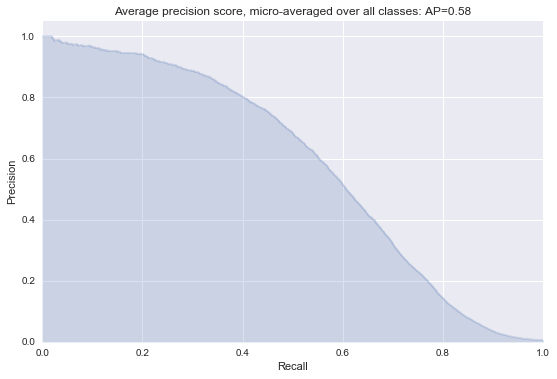

In [61]:
from __future__ import print_function
from sklearn.metrics import average_precision_score
from sklearn.metrics import precision_recall_curve
# Run classifier
clf = OneVsRestClassifier(LinearSVC(random_state=0))
clf.fit(X_tfidf_train_bodytitle, y_train_bodytitle)
y_score = clf.decision_function(X_tfidf_test_bodytitle)
n_classes = y_score.shape[1]

# For each class
precision = dict()
recall = dict()
average_precision = dict()
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test_bodytitle[:, i],
                                                        y_score[:, i])
    average_precision[i] = average_precision_score(
        y_test_bodytitle[:, i], y_score[:, i])

# A "micro-average": quantifying score on all classes jointly
precision["micro"], recall["micro"], _ = precision_recall_curve(y_test_bodytitle.ravel(),
                                                                y_score.ravel())
average_precision["micro"] = average_precision_score(y_test_bodytitle, y_score,
                                                     average="micro")
print('Average precision score, micro-averaged over all classes: {0:0.2f}'
      .format(average_precision["micro"]))

plt.figure()
plt.step(recall['micro'], precision['micro'], color='b', alpha=0.2,
         where='post')
plt.fill_between(recall["micro"], precision["micro"], alpha=0.2, color='b')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title(
    'Average precision score, micro-averaged over all classes: AP={0:0.2f}'
    .format(average_precision["micro"]))

In [62]:
mlpc = MLPClassifier()
mlpc.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

y_pred = mlpc.predict(X_tfidf_test_bodytitle)

print_score(y_pred, mlpc)

c:\program files\python37\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Clf:  MLPClassifier
Jacard score: 38.71082751866813
Hamming loss: 0.4583547557840617
Weighted F1 score: 0.4774290720097382
Macro F1 score: 0.37049167174019304
Micro F1 score: 0.5027192860131084


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.25      0.40         8
           1       0.26      0.20      0.23       108
           2       0.83      0.83      0.83         6
           3       0.85      0.53      0.65        32
           4       0.60      0.47      0.52        58
           5       0.67      0.29      0.40         7
           6       1.00      0.18      0.31        11
           7       0.84      0.82      0.83       295
           8       1.00      0.12      0.22         8
           9       0.57      0.25      0.35        16
          10       0.00      0.00      0.00         5
          11       0.60      0.60      0.60         5
          12       0.88      0.82      0.85        17
          13       0.50      0.50      0.50         6
          14       0.17      0.12      0.14         8
          15       0.17      0.06      0.08        18
          16       1.00      0.75      0.86         4
          17       0.60    


---


In [63]:
xgbc = OneVsRestClassifier(XGBClassifier(n_jobs=-1, max_depth=4))
xgbc.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

y_pred = xgbc.predict(X_tfidf_test_bodytitle)

print_score(y_pred, xgbc)

Clf:  OneVsRestClassifier
Jacard score: 40.45495164646835
Hamming loss: 0.38759640102827764
Weighted F1 score: 0.4780342912225138
Macro F1 score: 0.36863600325894075
Micro F1 score: 0.5313544175926647


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.25      0.40         8
           1       0.73      0.10      0.18       108
           2       0.80      0.67      0.73         6
           3       0.95      0.66      0.78        32
           4       0.75      0.47      0.57        58
           5       0.67      0.29      0.40         7
           6       0.67      0.18      0.29        11
           7       0.95      0.79      0.86       295
           8       1.00      0.25      0.40         8
           9       0.40      0.12      0.19        16
          10       0.00      0.00      0.00         5
          11       0.60      0.60      0.60         5
          12       0.88      0.82      0.85        17
          13       0.43      0.50      0.46         6
          14       0.50      0.25      0.33         8
          15       0.29      0.11      0.16        18
          16       1.00      0.75      0.86         4
          17       0.78    


---


In [64]:
knc = KNeighborsClassifier()
knc.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

y_pred = knc.predict(X_tfidf_test_bodytitle)

print_score(y_pred, knc)

Clf:  KNeighborsClassifier
Jacard score: 20.339760068551843
Hamming loss: 0.4820051413881748
Weighted F1 score: 0.27599369043401095
Macro F1 score: 0.23889219394872854
Micro F1 score: 0.30939226519337015


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.50      0.05      0.08       108
           2       1.00      0.50      0.67         6
           3       1.00      0.31      0.48        32
           4       0.67      0.07      0.12        58
           5       1.00      0.29      0.44         7
           6       1.00      0.18      0.31        11
           7       0.84      0.35      0.49       295
           8       1.00      0.12      0.22         8
           9       0.62      0.31      0.42        16
          10       0.00      0.00      0.00         5
          11       1.00      0.60      0.75         5
          12       0.93      0.76      0.84        17
          13       0.67      0.33      0.44         6
          14       0.00      0.00      0.00         8
          15       0.25      0.06      0.09        18
          16       0.00      0.00      0.00         4
          17       0.50    


---


In [65]:
rfc = RandomForestClassifier()
rfc.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

y_pred = rfc.predict(X_tfidf_test_bodytitle)

print_score(y_pred, rfc)

Clf:  RandomForestClassifier
Jacard score: 32.45415595544131
Hamming loss: 0.41433161953727504
Weighted F1 score: 0.3550493286448216
Macro F1 score: 0.14396137598471634
Micro F1 score: 0.4299230701211425


c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\program files\python37\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.70      0.13      0.22       108
           2       1.00      0.17      0.29         6
           3       1.00      0.16      0.27        32
           4       0.78      0.31      0.44        58
           5       0.50      0.14      0.22         7
           6       0.33      0.09      0.14        11
           7       0.96      0.78      0.86       295
           8       0.00      0.00      0.00         8
           9       1.00      0.06      0.12        16
          10       0.00      0.00      0.00         5
          11       0.00      0.00      0.00         5
          12       0.92      0.65      0.76        17
          13       0.00      0.00      0.00         6
          14       1.00      0.12      0.22         8
          15       0.00      0.00      0.00        18
          16       1.00      0.25      0.40         4
          17       1.00    


---


c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iter

c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iter

Best hyperparameters on the training set: {'estimator__C': 1}
jaccard score : 40.5932


array([<matplotlib.axes._subplots.AxesSubplot object at 0x000001FB30FDEB00>,
      dtype=object)

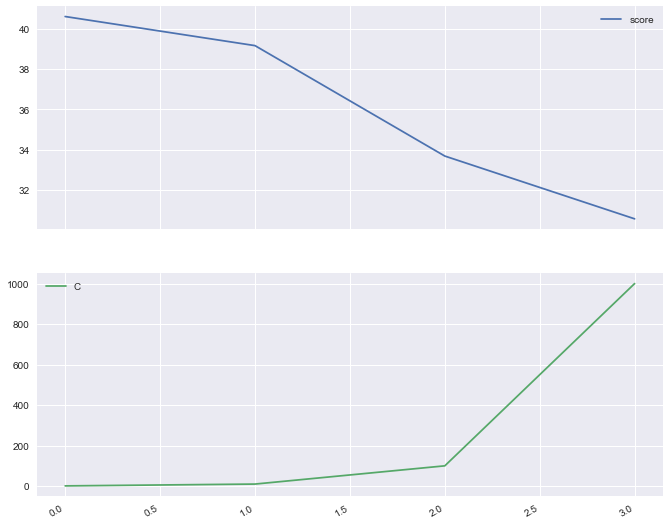

In [68]:
# Classification using OneVsRestClassifier with Linear SVC

svc = OneVsRestClassifier(LinearSVC(random_state=0))
param_grid = {'estimator__C': [1, 10, 100, 1000]}

# Choose cross-validation techniques for the inner and outer loops,
# independently of the dataset.
inner_cv = KFold(n_splits=5, shuffle=True, random_state=0)
outer_cv = KFold(n_splits=5, shuffle=True, random_state=0)

# Non_nested parameter search and scoring
svc_gs = GridSearchCV(svc, param_grid, cv=inner_cv,
                      scoring=make_scorer(avg_jaccard, greater_is_better=True))
svc_gs.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

# Nested CV with parameter optimization
nested_score = cross_val_score(
    svc_gs, X=X_tfidf_train_bodytitle, y=y_train_bodytitle, cv=outer_cv)

print("Best hyperparameters on the training set:",
      svc_gs.best_params_)
print("jaccard score : %.4f" % nested_score.mean())

svc_gs_df = pd.DataFrame(np.transpose([svc_gs.cv_results_['mean_test_score'],
                                       svc_gs.cv_results_['param_estimator__C'].data]),
                         columns=['score', 'C'])
svc_gs_df.plot(subplots=True, figsize=(10, 10))

In [69]:
svc_gs.best_estimator_

OneVsRestClassifier(estimator=LinearSVC(C=1, class_weight=None, dual=True,
                                        fit_intercept=True, intercept_scaling=1,
                                        loss='squared_hinge', max_iter=1000,
                                        multi_class='ovr', penalty='l2',
                                        random_state=0, tol=0.0001, verbose=0),
                    n_jobs=None)

c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
c:\program files\python37\lib\site-packages\sklearn\svm\_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Best hyperparameters on the training set: {'estimator__C': 10, 'estimator__penalty': 'l1'}
jaccard score : 41.0459


array([<matplotlib.axes._subplots.AxesSubplot object at 0x000001EA757D1978>,
      dtype=object)

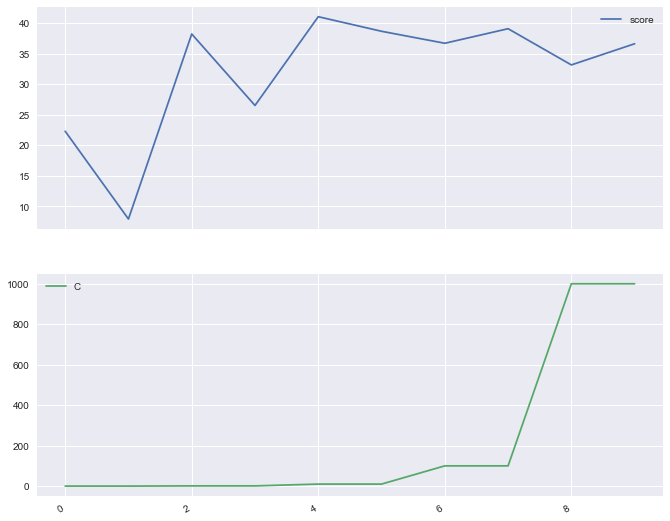

In [66]:
# Classification using OneVsRestClassifier with Logistic Regression

clf = OneVsRestClassifier(LogisticRegression(
    solver='liblinear', random_state=42))
param_grid = {'estimator__penalty': ['l1', 'l2'],
              'estimator__C': [0.1, 1, 10, 100, 1000]}

# Choose cross-validation techniques for the inner and outer loops,
# independently of the dataset.
inner_cv = KFold(n_splits=5, shuffle=True, random_state=0)
outer_cv = KFold(n_splits=5, shuffle=True, random_state=0)

# Non_nested parameter search and scoring
gs_lr = GridSearchCV(clf, param_grid, cv=inner_cv,
                     scoring=make_scorer(avg_jaccard, greater_is_better=True))
gs_lr.fit(X_tfidf_train_bodytitle, y_train_bodytitle)

# Nested CV with parameter optimization
nested_score = cross_val_score(
    gs_lr, X=X_tfidf_train_bodytitle, y=y_train_bodytitle, cv=outer_cv)

print("Best hyperparameters on the training set:",
      gs_lr.best_params_)
print("jaccard score : %.4f" % nested_score.mean())

gs_lr_df = pd.DataFrame(np.transpose([gs_lr.cv_results_['mean_test_score'],
                                      gs_lr.cv_results_['param_estimator__C'].data]),
                        columns=['score', 'C'])
gs_lr_df.plot(subplots=True, figsize=(10, 10))

In [67]:
test_jaccard_list = []
train_jaccard_list = []

for s in np.linspace(0, 1, 10, dtype='float'):

    y_train_pred = pd.DataFrame(gs_lr.best_estimator_.predict_proba(
        X_tfidf_train_bodytitle)).applymap(lambda x: 1 if x > s else 0).to_numpy()
    train_jaccard_list.append(jaccard_score(
        y_train_bodytitle, y_train_pred, average='weighted'))
    y_test_pred = pd.DataFrame(gs_lr.best_estimator_.predict_proba(
        X_tfidf_test_bodytitle)).applymap(lambda x: 1 if x > s else 0).to_numpy()
    test_jaccard_list.append(jaccard_score(
        y_test_bodytitle, y_test_pred, average='weighted'))

In [68]:
train_jaccard_list

[0.028733921406681618,
 0.6623015673573206,
 0.8026029563475128,
 0.8391091321816646,
 0.8132812684501732,
 0.7354267937267063,
 0.6111100838421144,
 0.47627169212756193,
 0.3615434732424423,
 0.0]

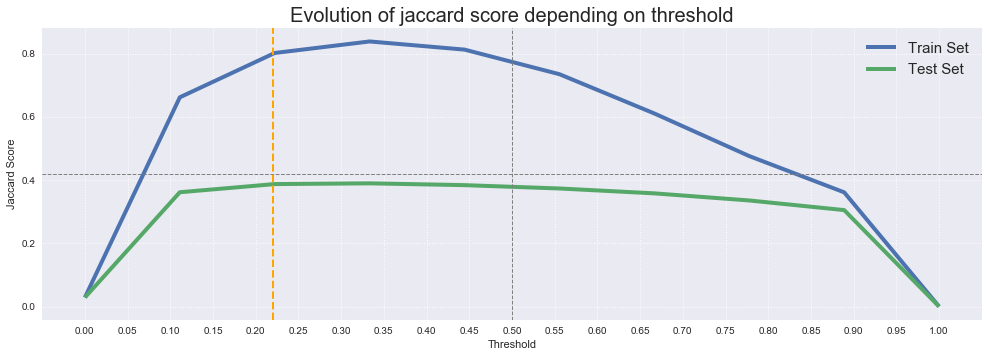

In [69]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(15, 5))
plt.style.use('fivethirtyeight')
plt.title("Evolution of jaccard score depending on threshold", fontsize=20)
plt.xlabel("Threshold")
plt.ylabel("Jaccard Score")
ax_train = ax.plot(np.linspace(0, 1, 10, dtype='float'), train_jaccard_list)
ax_test = ax.plot(np.linspace(0, 1, 10, dtype='float'), test_jaccard_list)
ax.axhline(y=0.42, color='gray', linestyle='--', lw=1)
ax.axvline(x=0.5, color='gray', linestyle='--', lw=1)
ax.axvline(x=0.22, color='orange', linestyle='--', lw=2)
plt.xticks(np.arange(0, 1.05, 0.05))
ax.legend((ax_train[0], ax_test[0]), ('Train Set', 'Test Set'), fontsize=15)
ax.grid(True, linestyle=":")
plt.show()

In [70]:
y_pred1 = pd.DataFrame(gs_lr.best_estimator_.predict_proba(
    X_tfidf_test_bodytitle)).applymap(lambda x: 1 if x > 0.5 else 0).to_numpy()
y_pred2 = pd.DataFrame(gs_lr.best_estimator_.predict_proba(
    X_tfidf_test_bodytitle)).applymap(lambda x: 1 if x > 0.22 else 0).to_numpy()
y_true = pd.Series(multilabel_binarizer.inverse_transform(y_test_bodytitle))
y_pred1 = pd.Series(multilabel_binarizer.inverse_transform(y_pred1))
y_pred2 = pd.Series(multilabel_binarizer.inverse_transform(y_pred2))
display(pd.concat([y_true.rename('y_true'), y_pred1.rename(
    'y_pred_0.5'), y_pred2.rename('y_pred_0.22')], axis=1)[:10])

,y_true,y_pred_0.5,y_pred_0.22
0,"(ios, xcode, xcode6)","(ios, xcode)","(c++, ios, xcode)"
1,"(javascript, php)","(javascript, php)","(arrays, javascript, oop, php)"
2,"(hash, security)","(security,)","(encryption, passwords, security)"
3,"(iteration, loops, performance, recursion)","(algorithm, iteration, recursion)","(algorithm, iteration, recursion)"
4,"(package, r)","(r, r-faq)","(package, r, r-faq)"
5,"(asp.net, javascript, jquery)","(javascript, jquery)","(ajax, javascript, jquery)"
6,"(c++, optimization, profiling)","(c++, performance)","(c++, performance)"
7,"(caching, http, http-headers, https)","(caching, html)","(caching, cross-browser, firefox, html, javasc..."
8,"(email, java, validation)","(email, java, validation)","(email, java, regex, validation)"
9,"(dataframe, pandas, python)","(dataframe, pandas, python, r)","(dataframe, pandas, python, r)"


On peut constater l’impact de la modification du seuil sur un échantillon tiré aléatoirement, le modèle est plus enclin à proposer un tag pour un seuil à 0.22 contrairement au seuil à 0.5, sans pour autant que le ou les tags proposés ne soient pas pertinents.

# Hyperparameters tuning ,Grid Search CV and Pipeline (Multiple Models)

In [71]:
class EstimatorSelectionHelper:

    def __init__(self, models, params):
        self.models = models
        self.params = params
        self.keys = models.keys()
        self.grid_searches = {}

    def fit(self, X, y, cv=3, n_jobs=3, verbose=1, scoring=None, refit=False):
        for key in self.keys:
            print('Running RandomizedSearchCV for %s.' % key)
            model = self.models[key]
            params = self.params[key]
            grid_search = RandomizedSearchCV(model, params, cv=cv, n_jobs=n_jobs,
                                             verbose=verbose, scoring=scoring, refit=refit,
                                             return_train_score=False)
            grid_search.fit(X, y)
            self.grid_searches[key] = grid_search
        print('Done.')

    def score_summary(self, sort_by='mean_test_score'):
        frames = []
        for name, grid_search in self.grid_searches.items():
            frame = pd.DataFrame(grid_search.cv_results_)
            frame = frame.filter(regex='^(?!.*param_).*$')
            frame['estimator'] = len(frame)*[name]
            frames.append(frame)
        df = pd.concat(frames)

        df = df.sort_values([sort_by], ascending=False)
        df = df.reset_index()
        df = df.drop(['rank_test_score', 'index'], 1)

        columns = df.columns.tolist()
        columns.remove('estimator')
        columns = ['estimator']+columns
        df = df[columns]
        return df

In [130]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier
import scipy.stats as stats

models1 = {
    'ExtraTreesClassifier': OneVsRestClassifier(ExtraTreesClassifier()),
    'RandomForestClassifier': RandomForestClassifier(),
    'AdaBoostClassifier': OneVsRestClassifier(AdaBoostClassifier(base_estimator=DecisionTreeClassifier())),
    'GradientBoostingClassifier': OneVsRestClassifier(GradientBoostingClassifier()),
    'LinearSVCClassifier': OneVsRestClassifier(LinearSVC(random_state=0)),
    'KNeighborsClassifier': KNeighborsClassifier(),
    'XGBClassifier': OneVsRestClassifier(XGBClassifier()),
    'MLPClassifier': MLPClassifier(),
    'PassiveAggressiveClassifier': OneVsRestClassifier(PassiveAggressiveClassifier()),
    'SGDClassifier': OneVsRestClassifier(SGDClassifier())

}

params1 = {
    'ExtraTreesClassifier': {'estimator__n_estimators': stats.randint(100, 150), 'estimator__min_samples_leaf': stats.randint(2, 20),
                             'estimator__min_samples_split': stats.randint(2, 20)},
    'RandomForestClassifier': {'n_estimators': [100, 150], 'min_samples_leaf': [2, 20],
                               'min_samples_split': [2, 20], 'criterion': ['gini', 'entropy']},
    'AdaBoostClassifier':  {'estimator__n_estimators': [100, 150]},
    'GradientBoostingClassifier': {'estimator__n_estimators': [100, 150], 'estimator__learning_rate': stats.uniform(0.8, 1.0)},
    'LinearSVCClassifier': {'estimator__C': [1, 10, 100, 1000]},
    'KNeighborsClassifier': {'leaf_size': [1, 50], 'n_neighbors': [1, 30], 'p': [1, 2]},
    'XGBClassifier': {'estimator__n_estimators': stats.randint(150, 1000),
                      'estimator__learning_rate':  stats.uniform(0.01, 0.6),
                      'estimator__subsample': stats.uniform(0.3, 0.9),
                      'estimator__max_depth': [3, 4, 5, 6, 7, 8, 9],
                      'estimator__colsample_bytree': stats.uniform(0.5, 0.9),
                      'estimator__min_child_weight': [1, 2, 3, 4]},
    'MLPClassifier': {'hidden_layer_sizes': [(50, 50, 50), (50, 100, 50), (100,)],
                      'activation': ['tanh', 'relu'],
                      'solver': ['sgd', 'adam'],
                      'alpha': [0.0001, 0.05],
                      'learning_rate': ['constant', 'adaptive']},
    'PassiveAggressiveClassifier': {'estimator__C': [1, 10, 100, 1000], 'estimator__loss': ['hinge', 'squared_hinge']},
    'SGDClassifier': {'estimator__alpha': [1e-4, 1e-3, 1e-2, 1e-1, 1e0, 1e1, 1e2, 1e3],  # learning rate
                      'estimator__max_iter': [1000],  # number of epochs
                      'estimator__loss': ['log'],  # logistic regression,
                      'estimator__penalty': ['l2']}

}

In [131]:
helper1 = EstimatorSelectionHelper(models1, params1)
helper1.fit(X_tfidf_train_bodytitle, y_train_bodytitle,
            scoring=make_scorer(avg_jaccard, greater_is_better=True), n_jobs=2)
helper1.score_summary()

Running RandomizedSearchCV for ExtraTreesClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 175.4min finished


Running RandomizedSearchCV for RandomForestClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 97.7min finished


Running RandomizedSearchCV for AdaBoostClassifier.
Fitting 3 folds for each of 2 candidates, totalling 6 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   6 out of   6 | elapsed: 74.9min finished


Running RandomizedSearchCV for GradientBoostingClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 808.0min finished


Running RandomizedSearchCV for LinearSVCClassifier.
Fitting 3 folds for each of 4 candidates, totalling 12 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  12 out of  12 | elapsed:  3.1min finished


Running RandomizedSearchCV for KNeighborsClassifier.
Fitting 3 folds for each of 8 candidates, totalling 24 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  24 out of  24 | elapsed: 26.7min finished


Running RandomizedSearchCV for XGBClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 231.2min finished


Running RandomizedSearchCV for MLPClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 42.8min finished


Running RandomizedSearchCV for PassiveAggressiveClassifier.
Fitting 3 folds for each of 8 candidates, totalling 24 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  24 out of  24 | elapsed:  3.4min finished


Running RandomizedSearchCV for SGDClassifier.
Fitting 3 folds for each of 8 candidates, totalling 24 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  24 out of  24 | elapsed:  4.2min finished


Done.


,estimator,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score
0,LinearSVCClassifier,21.539964,1.468075,0.571087,0.176906,{'estimator__C': 1},40.010695,38.942870,39.453244,39.468936,0.436079
1,PassiveAggressiveClassifier,10.960998,1.016242,0.339828,0.098871,"{'estimator__loss': 'hinge', 'estimator__C': 1}",39.096107,37.755040,38.676772,38.509306,0.560148
2,PassiveAggressiveClassifier,15.910490,2.028303,0.402263,0.058931,"{'estimator__loss': 'squared_hinge', 'estimato...",38.967581,37.937110,37.913001,38.272564,0.491549
3,LinearSVCClassifier,34.358935,2.033267,0.392809,0.192438,{'estimator__C': 10},38.829216,37.422173,38.252025,38.167804,0.577502
4,PassiveAggressiveClassifier,18.404531,0.760402,0.606116,0.314544,"{'estimator__loss': 'squared_hinge', 'estimato...",37.299813,36.336220,36.036259,36.557431,0.539038
...,...,...,...,...,...,...,...,...,...,...,...
75,XGBClassifier,0.584629,0.006054,0.000000,0.000000,{'estimator__colsample_bytree': 0.654799630239...,NaN,NaN,NaN,NaN,NaN
76,XGBClassifier,0.603175,0.043028,0.000000,0.000000,{'estimator__colsample_bytree': 1.279943167562...,NaN,NaN,NaN,NaN,NaN
77,XGBClassifier,0.545117,0.003988,0.000000,0.000000,{'estimator__colsample_bytree': 1.269965363809...,NaN,NaN,NaN,NaN,NaN
78,XGBClassifier,0.553195,0.011477,0.000000,0.000000,{'estimator__colsample_bytree': 1.293386606134...,NaN,NaN,NaN,NaN,NaN


In [132]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 10000)
helper1.score_summary()

,estimator,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score
0,LinearSVCClassifier,21.539964,1.468075,0.571087,0.176906,{'estimator__C': 1},40.010695,38.942870,39.453244,39.468936,0.436079
1,PassiveAggressiveClassifier,10.960998,1.016242,0.339828,0.098871,"{'estimator__loss': 'hinge', 'estimator__C': 1}",39.096107,37.755040,38.676772,38.509306,0.560148
2,PassiveAggressiveClassifier,15.910490,2.028303,0.402263,0.058931,"{'estimator__loss': 'squared_hinge', 'estimato...",38.967581,37.937110,37.913001,38.272564,0.491549
3,LinearSVCClassifier,34.358935,2.033267,0.392809,0.192438,{'estimator__C': 10},38.829216,37.422173,38.252025,38.167804,0.577502
4,PassiveAggressiveClassifier,18.404531,0.760402,0.606116,0.314544,"{'estimator__loss': 'squared_hinge', 'estimato...",37.299813,36.336220,36.036259,36.557431,0.539038
5,PassiveAggressiveClassifier,15.952806,1.135428,0.415413,0.026592,"{'estimator__loss': 'hinge', 'estimator__C': 10}",36.908137,36.091427,36.598726,36.532763,0.336667
6,PassiveAggressiveClassifier,17.028530,0.362545,0.393267,0.013356,"{'estimator__loss': 'hinge', 'estimator__C': 1...",36.627359,35.505706,36.072799,36.068621,0.457923
7,PassiveAggressiveClassifier,18.453314,0.524168,0.525388,0.098152,"{'estimator__loss': 'hinge', 'estimator__C': 100}",36.979161,34.748807,36.037157,35.921709,0.914190
8,PassiveAggressiveClassifier,16.413692,0.401552,0.483388,0.106298,"{'estimator__loss': 'squared_hinge', 'estimato...",36.092643,35.063714,35.827395,35.661251,0.436178
9,XGBClassifier,7229.078358,973.729934,49.828790,5.407788,{'estimator__colsample_bytree': 0.908335325200...,35.148081,34.649444,35.666515,35.154680,0.415244


In [93]:
models2 = {
    'LinearSVCClassifier': OneVsRestClassifier(LinearSVC(random_state=0, max_iter=10000))
}

params2 = {
    'LinearSVCClassifier': {'estimator__C': [1, 10, 100, 1000], 'estimator__penalty': ['l1', 'l2'], 'estimator__loss': ['hinge', 'squared_hinge']}
}

In [94]:
helper2 = EstimatorSelectionHelper(models2, params2)
helper2.fit(X_tfidf_train_bodytitle, y_train_bodytitle,
            scoring=make_scorer(avg_jaccard, greater_is_better=True), n_jobs=2)
helper2.score_summary()

Running RandomizedSearchCV for LinearSVCClassifier.
Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  30 out of  30 | elapsed: 17.0min finished


Done.


,estimator,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score
0,LinearSVCClassifier,18.235466,1.188632,0.442201,0.127789,"{'estimator__penalty': 'l2', 'estimator__loss'...",39.160606,39.742251,40.437664,39.780174,0.522046
1,LinearSVCClassifier,35.028509,2.837850,0.350103,0.030881,"{'estimator__penalty': 'l2', 'estimator__loss'...",38.459910,38.754213,39.358107,38.857410,0.373878
2,LinearSVCClassifier,110.383679,8.476417,0.452200,0.134854,"{'estimator__penalty': 'l2', 'estimator__loss'...",34.242290,34.231261,35.267109,34.580220,0.485725
3,LinearSVCClassifier,126.199540,4.116714,0.364792,0.048301,"{'estimator__penalty': 'l2', 'estimator__loss'...",33.340290,33.775061,34.405680,33.840344,0.437386
4,LinearSVCClassifier,167.670975,7.424473,0.662169,0.232612,"{'estimator__penalty': 'l2', 'estimator__loss'...",31.079045,31.066784,31.872152,31.339327,0.376798
5,LinearSVCClassifier,174.790663,33.844734,0.505180,0.240823,"{'estimator__penalty': 'l2', 'estimator__loss'...",29.099653,29.174900,30.588978,29.621177,0.685028
6,LinearSVCClassifier,0.846796,0.184203,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss'...",NaN,NaN,NaN,NaN,NaN
7,LinearSVCClassifier,0.608804,0.030727,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss'...",NaN,NaN,NaN,NaN,NaN
8,LinearSVCClassifier,0.636010,0.038547,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss'...",NaN,NaN,NaN,NaN,NaN
9,LinearSVCClassifier,0.747811,0.119727,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss'...",NaN,NaN,NaN,NaN,NaN


In [95]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 10000)
pd.set_option('max_colwidth', 400)
helper2.score_summary()

,estimator,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score
0,LinearSVCClassifier,18.235466,1.188632,0.442201,0.127789,"{'estimator__penalty': 'l2', 'estimator__loss': 'squared_hinge', 'estimator__C': 1}",39.160606,39.742251,40.437664,39.780174,0.522046
1,LinearSVCClassifier,35.028509,2.837850,0.350103,0.030881,"{'estimator__penalty': 'l2', 'estimator__loss': 'squared_hinge', 'estimator__C': 10}",38.459910,38.754213,39.358107,38.857410,0.373878
2,LinearSVCClassifier,110.383679,8.476417,0.452200,0.134854,"{'estimator__penalty': 'l2', 'estimator__loss': 'hinge', 'estimator__C': 100}",34.242290,34.231261,35.267109,34.580220,0.485725
3,LinearSVCClassifier,126.199540,4.116714,0.364792,0.048301,"{'estimator__penalty': 'l2', 'estimator__loss': 'squared_hinge', 'estimator__C': 100}",33.340290,33.775061,34.405680,33.840344,0.437386
4,LinearSVCClassifier,167.670975,7.424473,0.662169,0.232612,"{'estimator__penalty': 'l2', 'estimator__loss': 'hinge', 'estimator__C': 1000}",31.079045,31.066784,31.872152,31.339327,0.376798
5,LinearSVCClassifier,174.790663,33.844734,0.505180,0.240823,"{'estimator__penalty': 'l2', 'estimator__loss': 'squared_hinge', 'estimator__C': 1000}",29.099653,29.174900,30.588978,29.621177,0.685028
6,LinearSVCClassifier,0.846796,0.184203,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss': 'squared_hinge', 'estimator__C': 10}",NaN,NaN,NaN,NaN,NaN
7,LinearSVCClassifier,0.608804,0.030727,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss': 'hinge', 'estimator__C': 100}",NaN,NaN,NaN,NaN,NaN
8,LinearSVCClassifier,0.636010,0.038547,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss': 'squared_hinge', 'estimator__C': 1000}",NaN,NaN,NaN,NaN,NaN
9,LinearSVCClassifier,0.747811,0.119727,0.000000,0.000000,"{'estimator__penalty': 'l1', 'estimator__loss': 'squared_hinge', 'estimator__C': 1}",NaN,NaN,NaN,NaN,NaN


# Evaluation of the final model (OVR with Logistic Regression)

In [85]:
def plot_confusion_matrix(cm, classes, title, cmap=plt.cm.Reds):
    ''' This function prints and plots a normalized confusion matrix.

  Parameters:

      cm : the confusion matrix 
      classes (list): the labels to diplay on the graph
      title (string): the title of the confusion matrix plot

  '''

    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, bbox={"pad": 3, 'alpha': 0.5,
                           "facecolor": 'red'}, size=18)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

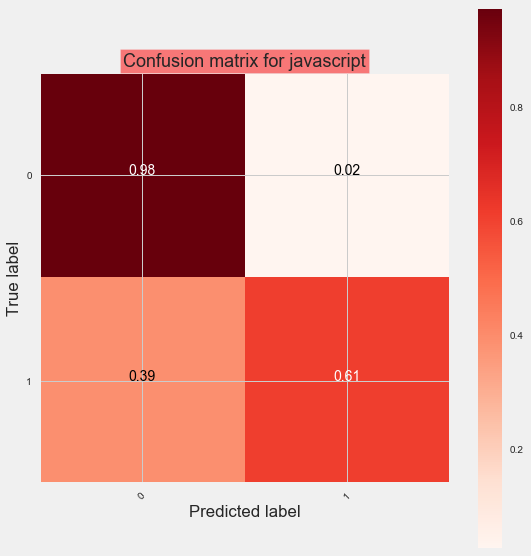

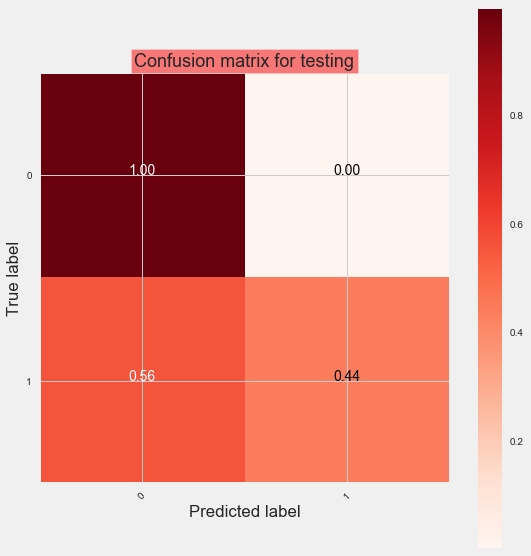

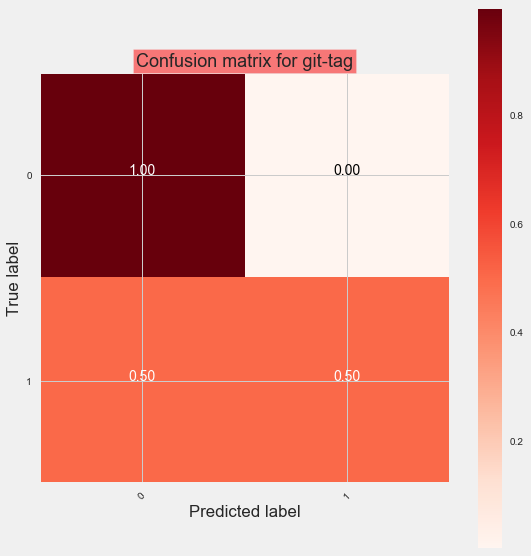

In [87]:
# Confusion matrix of the OneVersusRest Classifier for different tags

top_tag = np.where(multilabel_binarizer.classes_ == top_tags[0])[0]
middle_tag = np.where(multilabel_binarizer.classes_ == top_tags[199])[0]
bottom_tag = np.where(multilabel_binarizer.classes_ == top_tags[399])[0]

for i in [top_tag, middle_tag, bottom_tag]:

    tag = (multilabel_binarizer.classes_[i])
    y_pred = gs_lr.predict(X_tfidf_test_bodytitle)
    cnf_matrix = confusion_matrix(y_test_bodytitle[:, i], y_pred[:, i])
    plot_confusion_matrix(cnf_matrix, classes=[0, 1],
                          title='Confusion matrix for %s' % tag[0])
    print("")

# There is no difference concerning the performance of OVR, for predicting
# the different tags (popular or not)

Confusion matrix, without normalization


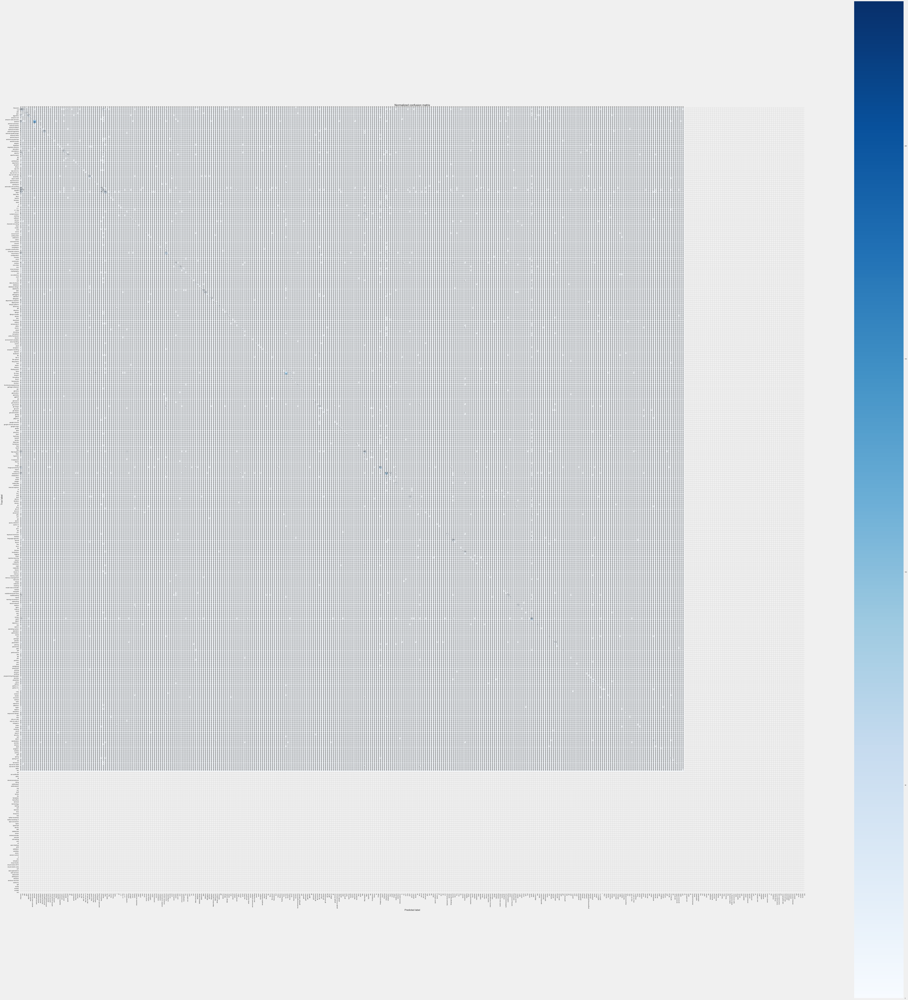

In [88]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    # print(cm)

    plt.imshow(cm, interpolation='lanczos', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


label_names = multilabel_binarizer.classes_
y_pred = gs_lr.predict(X_tfidf_test_bodytitle)
cnf_matrix = confusion_matrix(
    np.argmax(y_test_bodytitle, axis=1), np.argmax(y_pred, axis=1))

# Plot normalized confusion matrix
fig = plt.figure()
fig.set_size_inches(100, 100, forward=True)
fig.align_labels()

fig.subplots_adjust(left=0.0, right=1.0, bottom=0.0, top=1.0)
plot_confusion_matrix(cnf_matrix, classes=np.asarray(label_names), normalize=False,
                      title='Normalized confusion matrix')

In [74]:
# Jaccard Score of OVR on test set

lr_ovr = OneVsRestClassifier(LogisticRegression(
    solver='liblinear', random_state=42, C=10.0, penalty='l1'))
lr_ovr.fit(X_tfidf_train_bodytitle, y_train_bodytitle)
y_pred = lr_ovr.predict(X_tfidf_test_bodytitle)
jaccard = avg_jaccard(y_test_bodytitle, y_pred)
print('Jaccard score in percentage for OVR with LogisticRegression: %.2f' % jaccard)

Jaccard score in percentage for OVR with LogisticRegression: 41.01


In [91]:
# SAUVEGARDE
with open('lr_ovr.pkl', 'wb') as f:
    pickle.dump(lr_ovr, f)

In [75]:
multilabel_binarizer.classes_

array(['.htaccess', '.net', 'adb', 'ajax', 'algorithm', 'amazon-ec2',
       'amazon-web-services', 'android', 'android-actionbar',
       'android-activity', 'android-edittext', 'android-emulator',
       'android-fragments', 'android-gradle-plugin', 'android-intent',
       'android-layout', 'android-recyclerview', 'android-studio',
       'angular', 'angularjs', 'angularjs-directive', 'animation',
       'annotations', 'apache', 'apache-spark', 'api', 'apk',
       'architecture', 'arguments', 'arraylist', 'arrays', 'asp.net',
       'asp.net-mvc', 'asp.net-mvc-3', 'asp.net-web-api', 'assembly',
       'async-await', 'asynchronous', 'authentication', 'autolayout',
       'automatic-ref-counting', 'backbone.js', 'base64', 'bash',
       'batch-file', 'big-o', 'branch', 'browser', 'build', 'c', 'c#',
       'c++', 'c++-faq', 'c++11', 'c-preprocessor', 'caching', 'callback',
       'canvas', 'casting', 'character-encoding', 'class', 'cmake', 'cmd',
       'cocoa', 'cocoa-touch', 'codin

# Programs of Recommendation System

In [78]:
# Program of the recommendation system using lda (Unsupervised)

text = input('Ask a question: ')
tags = Recommend_tags_lda(text, X_train_bodytitle)
print('Recommended tags are:', tags)

Ask a question: Well, i have simple console programm (written in php), which outputs some information and then wait for user input and after input, again outputs some another information.  I need to write nodejs programm that will:  Catch first output from this program Somehow saving this interaction in order to send command to it later. Process and show new text to user and wait for input (inside node) Grab user input and passes it to opened programm Show last output from php programm in node end nodejs To keep it simple lets pretend the program is:  <?php $line = readline("Enter your command: "); print 'Thank you for submitting data.'; ?> My main problem is that i don't know how to handle "holding" php program opened.  What i ended up for now in node is this:  const readline = require('readline'); const exec = require('child_process').exec; const rl = readline.createInterface({   input: process.stdin,   output: process.stdout });  exec('php programm.php', function(error, stdout, stde

In [79]:
# Program of the recommendation system Supervised

text = input('Ask a question: ')
text = clean_text(text)
text = BeautifulSoup(text).get_text()
text = clean_punct(text)
text = stopWordsRemove(text)
text = lemmatization(text, ['NOUN', 'ADV'])
cleaned_text = [text]
TfIdfText = vectorizer_dfText.transform(cleaned_text)
encoded_y_pred = lr_ovr.predict(TfIdfText)
tu_tags = multilabel_binarizer.inverse_transform(encoded_y_pred)
print('Recommended tags are:', tu_tags)

Ask a question: Well, i have simple console programm (written in php), which outputs some information and then wait for user input and after input, again outputs some another information.  I need to write nodejs programm that will:  Catch first output from this program Somehow saving this interaction in order to send command to it later. Process and show new text to user and wait for input (inside node) Grab user input and passes it to opened programm Show last output from php programm in node end nodejs To keep it simple lets pretend the program is:  <?php $line = readline("Enter your command: "); print 'Thank you for submitting data.'; ?> My main problem is that i don't know how to handle "holding" php program opened.  What i ended up for now in node is this:  const readline = require('readline'); const exec = require('child_process').exec; const rl = readline.createInterface({   input: process.stdin,   output: process.stdout });  exec('php programm.php', function(error, stdout, stde

In [56]:
def pred_nwords_unsupervised(text, tfidf, lda, n_words):
    ''' Recommend n_words tags by detecting latent topics in a corpus
    Parameters:    
    text: cleaned text on which recommendations are based
    tfidf: tfidf transformer
    lda: lda model
    n_words: number of words retrieved
    '''

    document_tfidf = tfidf.transform(text)
    proba_topic_sachant_document = lda.transform(document_tfidf)
    words_label = []
    for word in tfidf.get_feature_names():
        words_label.append(word)
    proba_word_sachant_topic = lda.components_ / \
        lda.components_.sum(axis=1)[:, np.newaxis]  # normalization

    # proba_topic_sachant_document est de dimension d x t
    # proba_word_sachant_topic est de dimension t x w
    # je peux donc opérer un produit matriciel entre les 2 matrices pour calculer pour chaque document : proba(wordn)
    # j'obtiendrai une matrice proba_word_sachant_document de dimension d x w
    # il ne me restera plus qu'à choisir les "n_words" mots les plus probables
    proba_word_sachant_document = proba_topic_sachant_document.dot(
        proba_word_sachant_topic)

    # je transforme la matrice en dataframe :
    # data = les proba des mots pour chaque document
    # index = l'index des données en entrée
    # columns = les labels des mots sélectionnés en sortie du LDA
    df_wd = pd.DataFrame(data=proba_word_sachant_document,
                         index=text.index,
                         columns=words_label)

    values = df_wd.columns.values[np.argsort(
        -df_wd.values, axis=1)[:, :n_words]]
    values = [", ".join(item) for item in values.astype(str)]
    pred_unsupervised = pd.DataFrame(values,
                                     index=df_wd.index,
                                     columns=['Unsupervised'])

    return pred_unsupervised

In [57]:
def recommend_tags(text_ori, n_words, seuil=0.5, clean=False):
    ''' Recommendation system for StackOverflow posts based on a unsupervised AND supervised model which returns up to 5 words.
    Parameters:
    text_ori: the stackoverflow post of user
    n_words: number of tags to recommend
    seuil: threshold for decision
    clean: True if data preparation is needed
    '''

    if type(text_ori) in (str, pd.Series):
        if type(text_ori) is str:
            text_ori = pd.Series(text_ori)
        text = text_ori
        text_ori = text_ori.rename("Texte d'origine")
        text = text.rename("Texte modifié")
    else:
        return 'Type should be str or pd.Series'

    if clean == True:
        text = text.apply(lambda s: clean_text(s))
        text = text.apply(lambda s: BeautifulSoup(s).get_text())
        text = text.apply(lambda s: clean_punct(s))
        text = text.apply(lambda s: stopWordsRemove(s))
        text = text.apply(lambda s: lemmatization(s, ['NOUN', 'ADV']))

    pred_unsupervised = pred_nwords_unsupervised(
        text, vectorizer_dfText, best_lda, n_words)
    pred_supervised = pd.DataFrame(lr_ovr.predict_proba(vectorizer_dfText.transform(
        text))).applymap(lambda x: 1 if x > seuil else 0).to_numpy()
    pred_supervised = pd.Series(multilabel_binarizer.inverse_transform(
        pred_supervised), name='Supervised', index=text.index)
    pred_supervised = pred_supervised.apply(lambda row: ', '.join(row))
    result = pd.concat(
        [pred_supervised, pred_unsupervised, text_ori, text], axis=1)

    return result

In [92]:
test = 'this sql request grouping values by keys on the relational database is not working.'
display(recommend_tags(test, 5, seuil=0.22, clean=True))

test = 'I want to develop a web application generating html, javascript and css, what is the good language to do that.'
display(recommend_tags(test, 5, seuil=0.22, clean=True))

test = 'I want to code a Python function to sum item from a dictionary.'
display(recommend_tags(test, 5, seuil=0.22, clean=True))

test = df['Text'].loc[2:10]
display(recommend_tags(test, 5, seuil=0.22, clean=False))

,Supervised,Unsupervised,Texte d'origine,Texte modifié
0,sql,"android, table, column, sql, database",this sql request grouping values by keys on th...,sql request grouping value key database


,Supervised,Unsupervised,Texte d'origine,Texte modifié
0,"html, javascript","javascript, css, jquery, browser, element",I want to develop a web application generating...,web application html javascript css language


,Supervised,Unsupervised,Texte d'origine,Texte modifié
0,"dictionary, python","static, java, memory, language, difference",I want to code a Python function to sum item f...,python function dictionary


,Supervised,Unsupervised,Texte d'origine,Texte modifié
2,visual-studio,"java, php, vim, random, number",tab behavior document studiois change ctrl tab...,tab behavior document studiois change ctrl tab...
3,"c#, mysql, optimization, sql, string","text, input, html, jquery, value",way way concatenate string,way way concatenate string
4,"php, profiling","java, php, difference, vim, value",php scriptwhat way php script love show functi...,php scriptwhat way php script love show functi...
5,".net, c#, dependency-injection","image, docker, install, size, container",.net dependency injection frameworks injection...,.net dependency injection frameworks injection...
6,"file, import, javascript","text, input, html, page, jquery",dynamically javascript reliably dynamically ja...,dynamically javascript reliably dynamically ja...
7,.net,"project, error, import, application, build",mono source .net implementation project world ...,mono source .net implementation project world ...
8,"c#, database, entity-framework, java-ee, sql-s...","android, table, column, sql, datum",objectsi really debate merit currently enterpr...,objectsi really debate merit currently enterpr...
9,"linq, sql-server, sql-server-2005","android, table, column, sql, database",deadlock sql server deadlock condition sql ser...,deadlock sql server deadlock condition sql ser...
10,"command-line, parsing, python","array, line, exception, element, xml",way parse command line method library parsing ...,way parse command line method library parsing ...
